# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''    
    return F.one_hot(labels, n_classes)

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    combined = torch.cat((x.float(),y.float()),1)
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:

def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = n_classes + mnist_shape[0]
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()

print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.1023275555372236, discriminator loss: 0.282047817543149


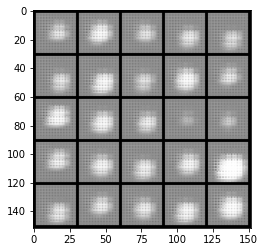

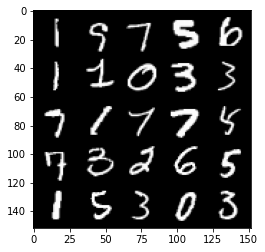

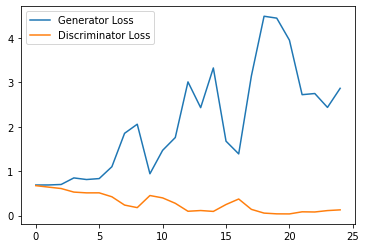

Step 1000: Generator loss: 4.297084778785705, discriminator loss: 0.05021761503070593


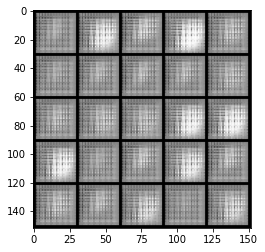

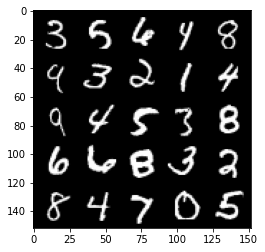

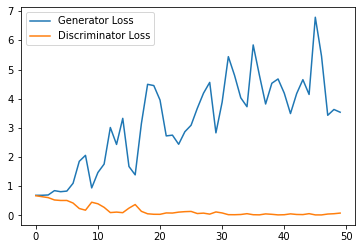

Step 1500: Generator loss: 4.878692334651947, discriminator loss: 0.03365379500761628


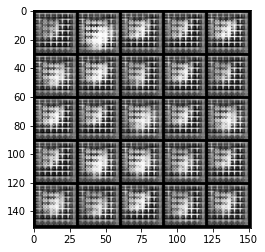

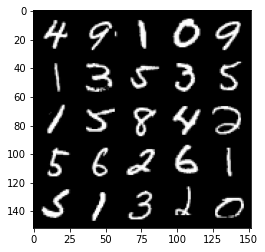

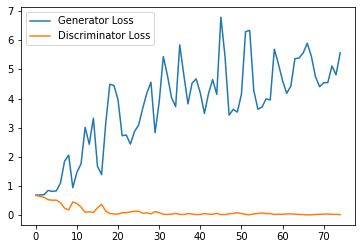

Step 2000: Generator loss: 5.272030132770539, discriminator loss: 0.0185295820501633


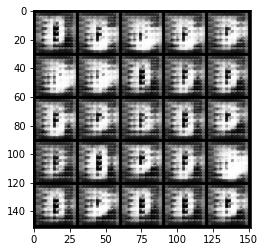

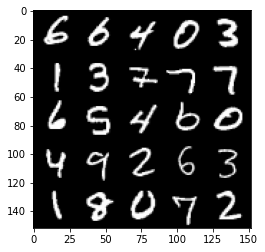

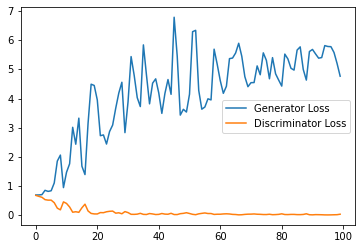

Step 2500: Generator loss: 5.815434639930725, discriminator loss: 0.02061810164619237


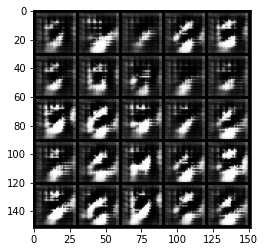

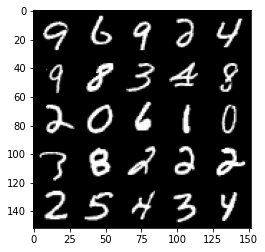

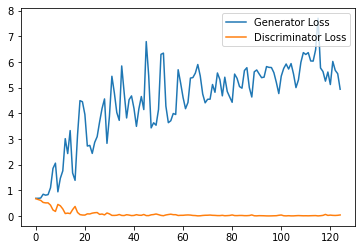

Step 3000: Generator loss: 4.273444121837616, discriminator loss: 0.0741719634346664


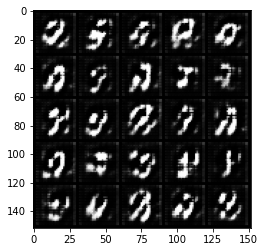

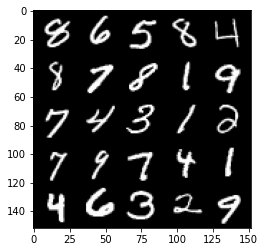

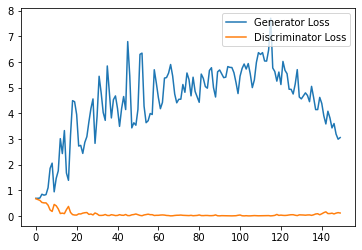

Step 3500: Generator loss: 3.0246615641117094, discriminator loss: 0.19413102615624667


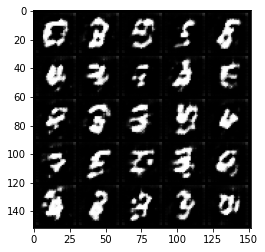

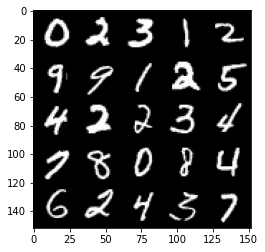

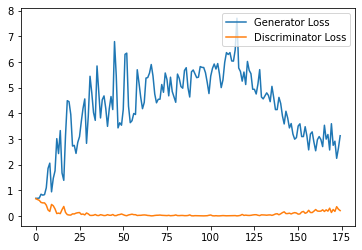

Step 4000: Generator loss: 2.336828619003296, discriminator loss: 0.29677057710289956


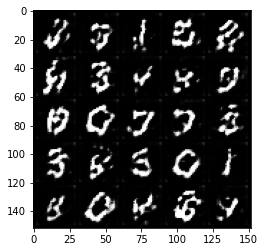

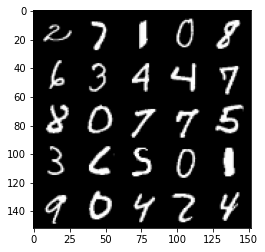

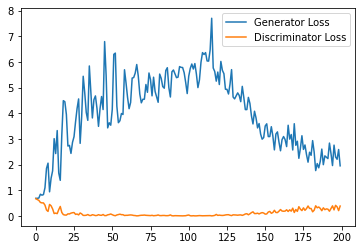

Step 4500: Generator loss: 2.1647226135730744, discriminator loss: 0.3209577185511589


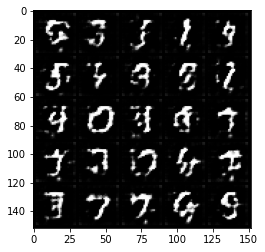

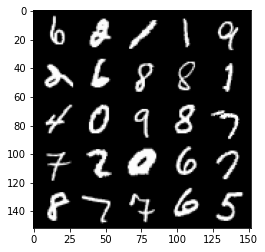

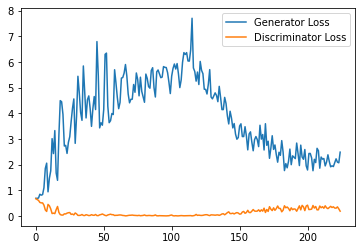

Step 5000: Generator loss: 1.9410848705768584, discriminator loss: 0.32510557293891906


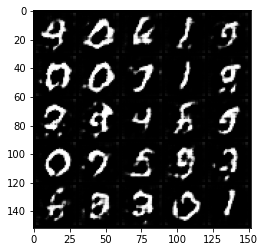

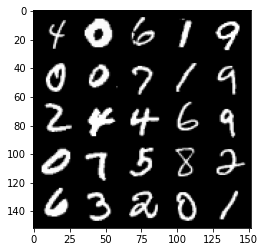

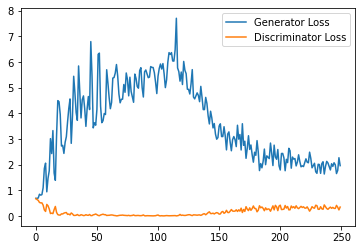

Step 5500: Generator loss: 1.9188547887802123, discriminator loss: 0.34032304751873016


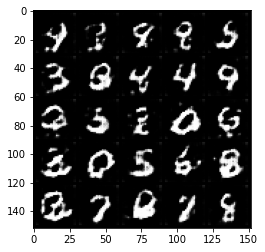

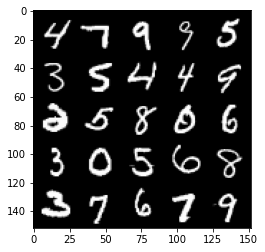

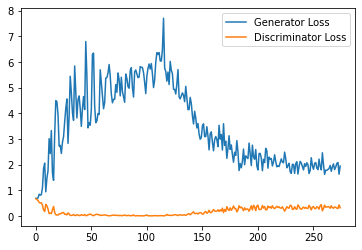

Step 6000: Generator loss: 1.959183831691742, discriminator loss: 0.37150599628686903


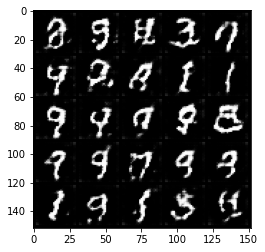

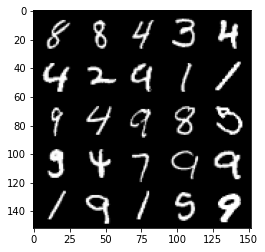

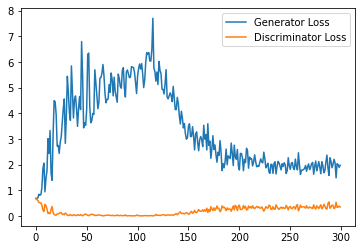

Step 6500: Generator loss: 1.7459503781795502, discriminator loss: 0.3821510819196701


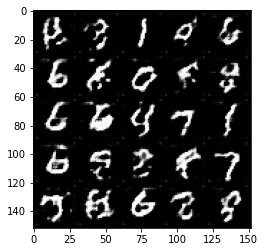

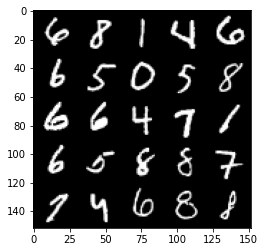

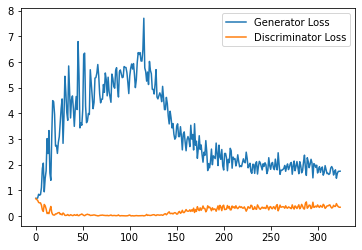

Step 7000: Generator loss: 1.652567033290863, discriminator loss: 0.41276542723178866


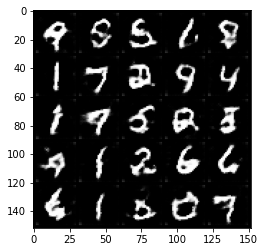

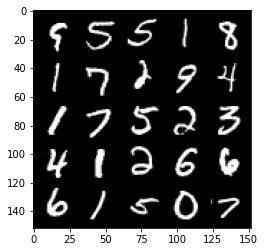

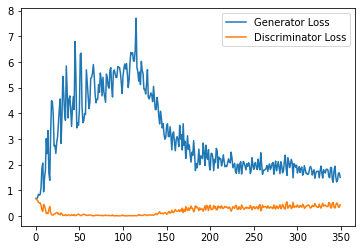

Step 7500: Generator loss: 1.5055095076560974, discriminator loss: 0.439686399936676


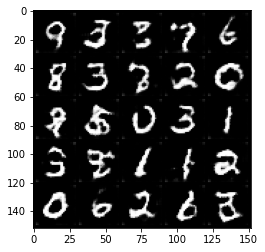

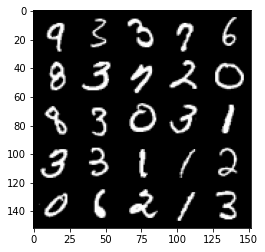

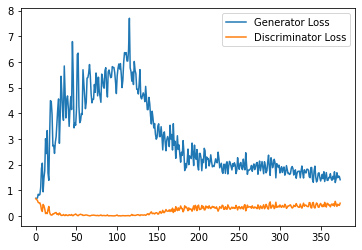

Step 8000: Generator loss: 1.4938201884031295, discriminator loss: 0.48017273205518723


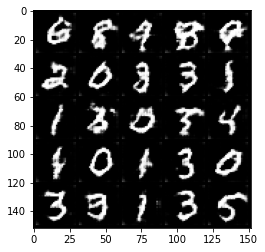

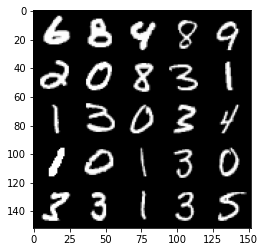

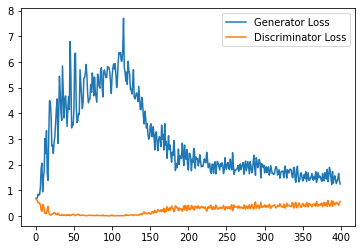

Step 8500: Generator loss: 1.4188512679338454, discriminator loss: 0.49960592716932295


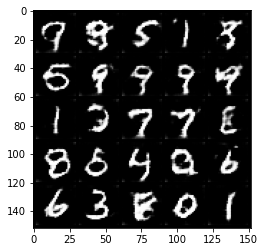

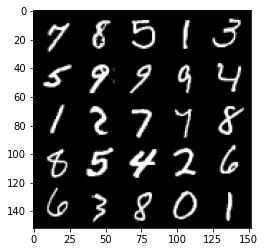

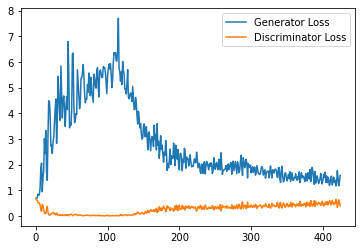

Step 9000: Generator loss: 1.3181082130670547, discriminator loss: 0.5308516358733177


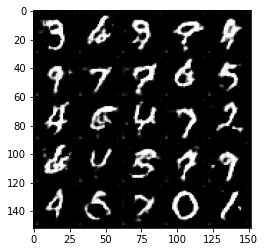

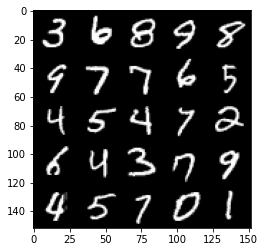

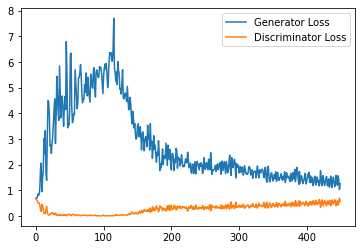

Step 9500: Generator loss: 1.276061993598938, discriminator loss: 0.533995993077755


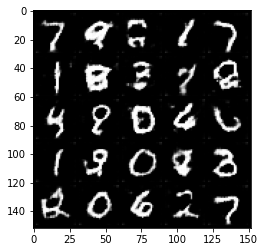

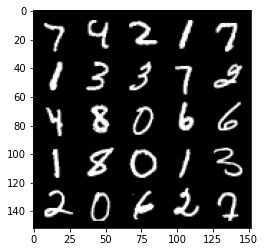

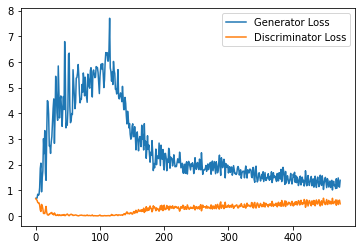

Step 10000: Generator loss: 1.3262206357717514, discriminator loss: 0.5367021043896675


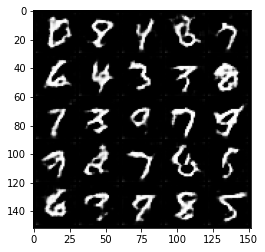

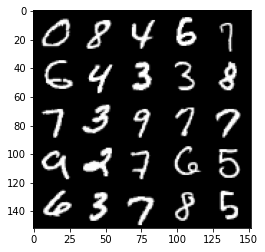

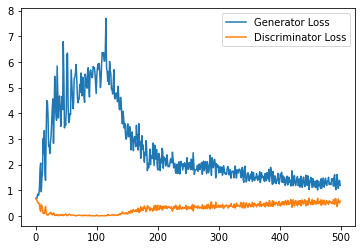

Step 10500: Generator loss: 1.2356951166391372, discriminator loss: 0.5419302505254745


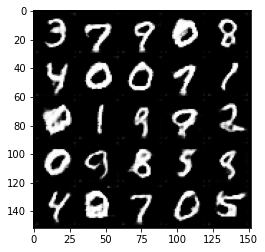

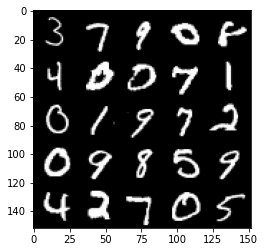

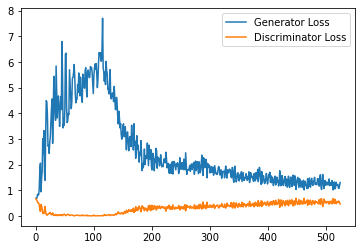

Step 11000: Generator loss: 1.204810073018074, discriminator loss: 0.5475508897304535


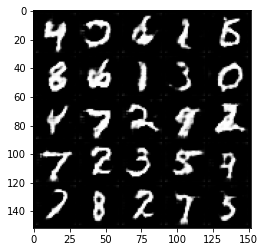

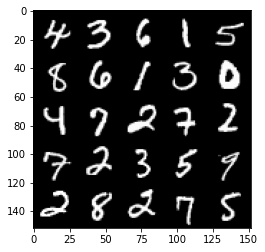

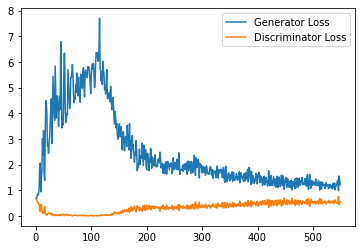

Step 11500: Generator loss: 1.2139945971965789, discriminator loss: 0.550652559041977


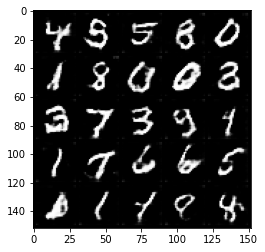

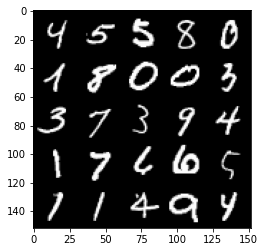

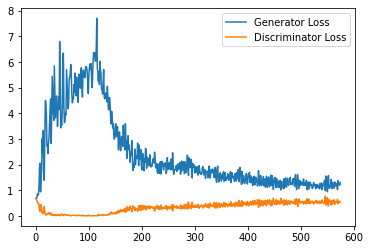

Step 12000: Generator loss: 1.2050212491750718, discriminator loss: 0.5537574554681778


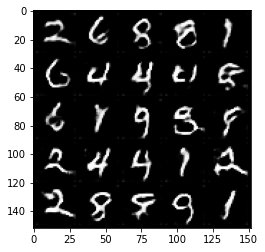

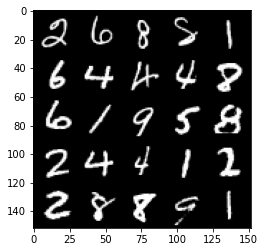

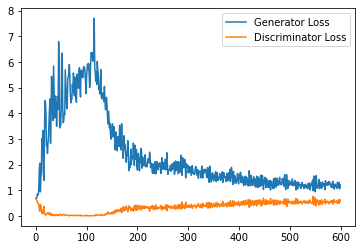

Step 12500: Generator loss: 1.174706509590149, discriminator loss: 0.5615185545682907


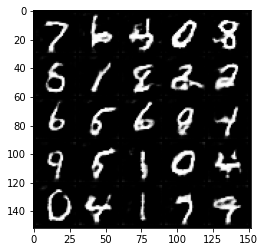

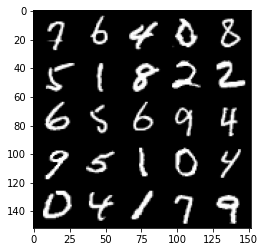

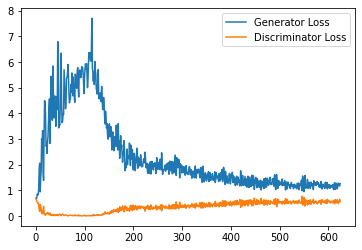

Step 13000: Generator loss: 1.1975299314260484, discriminator loss: 0.5650463037490845


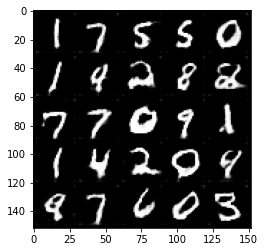

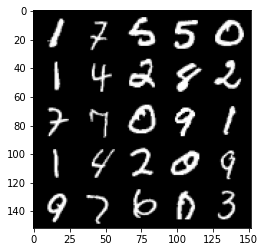

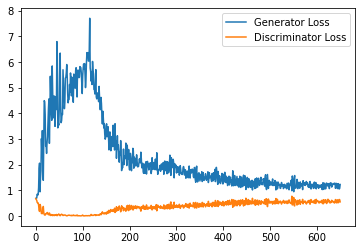

Step 13500: Generator loss: 1.229574774980545, discriminator loss: 0.5509334763288498


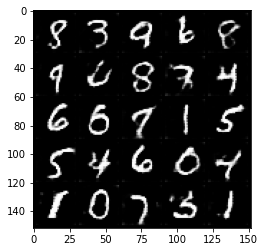

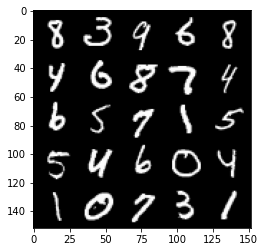

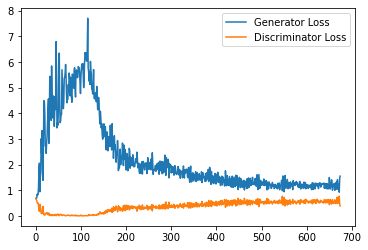

Step 14000: Generator loss: 1.0938783268928527, discriminator loss: 0.5796092776656151


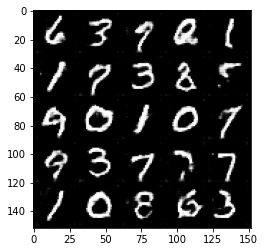

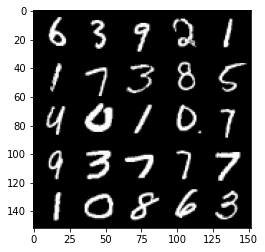

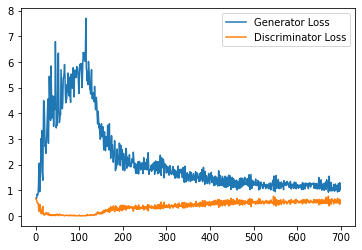

Step 14500: Generator loss: 1.1106398940086364, discriminator loss: 0.5780310805439949


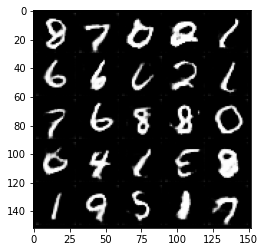

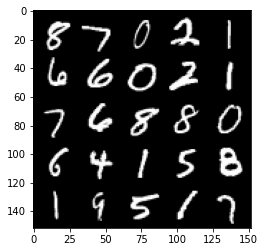

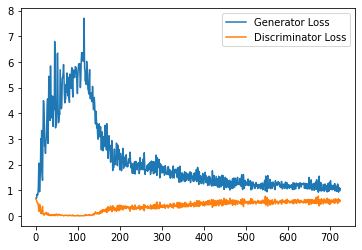

Step 15000: Generator loss: 1.0889985511302949, discriminator loss: 0.5688818472623826


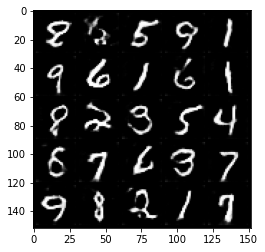

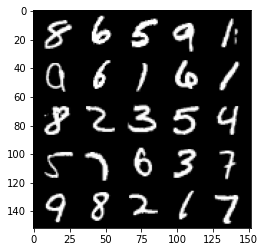

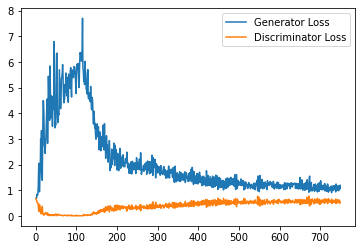

Step 15500: Generator loss: 1.0925200330018998, discriminator loss: 0.5872384026646614


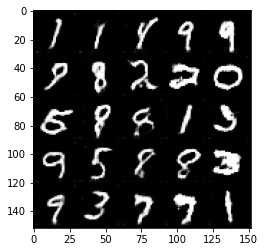

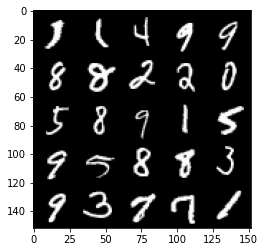

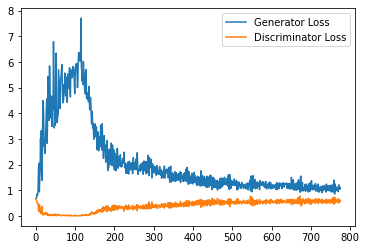

Step 16000: Generator loss: 1.1195946143865585, discriminator loss: 0.5781604472398758


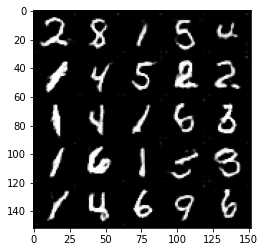

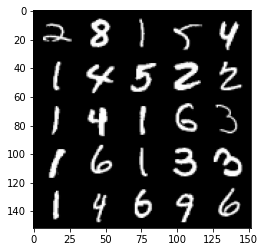

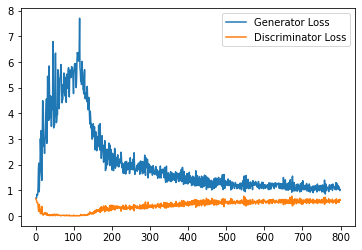

Step 16500: Generator loss: 1.069155489206314, discriminator loss: 0.5798646664023399


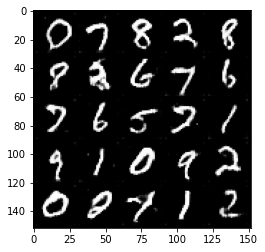

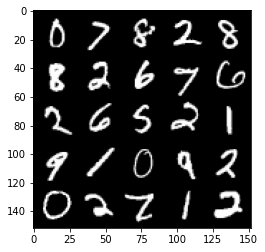

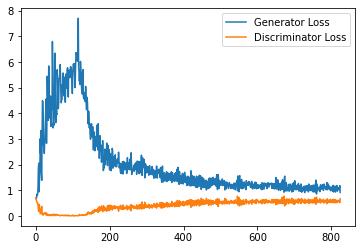

Step 17000: Generator loss: 1.0519636124372482, discriminator loss: 0.5881960553526878


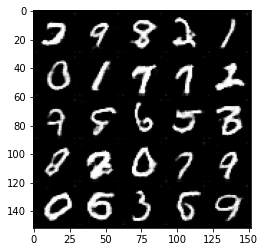

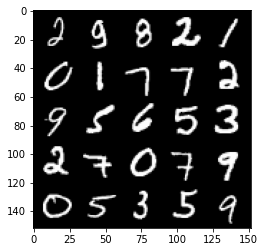

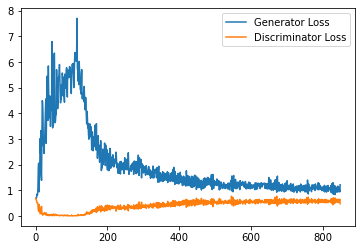

Step 17500: Generator loss: 1.053834307551384, discriminator loss: 0.5972992477416992


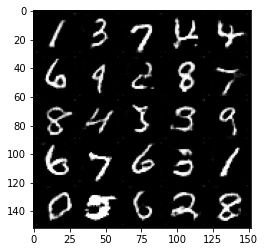

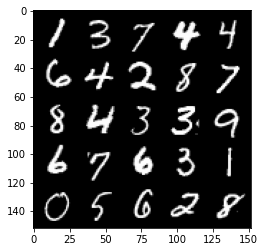

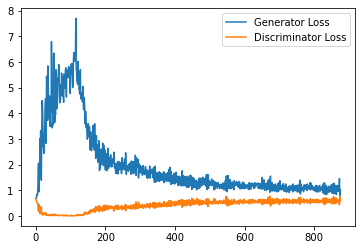

Step 18000: Generator loss: 1.01909779047966, discriminator loss: 0.5928230500221252


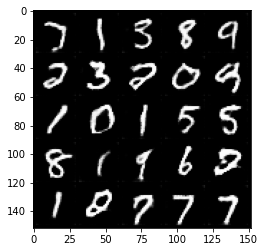

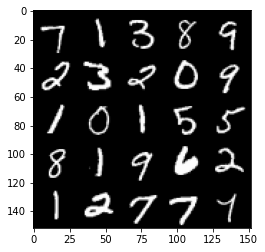

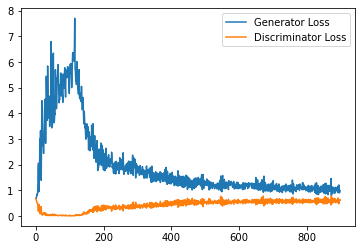

Step 18500: Generator loss: 1.0520008568763732, discriminator loss: 0.5863508643507958


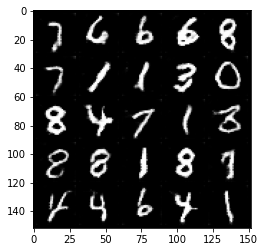

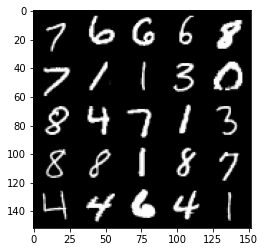

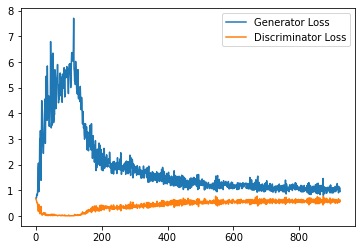

Step 19000: Generator loss: 1.0576282080411912, discriminator loss: 0.5888769731521607


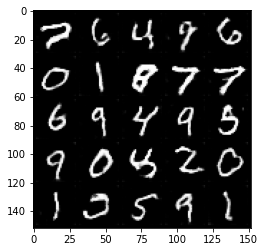

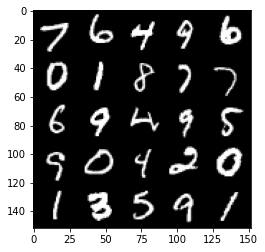

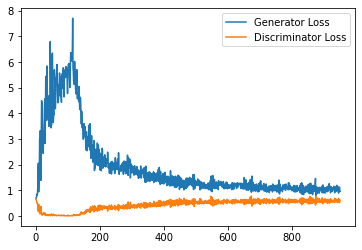

Step 19500: Generator loss: 1.0250590304136276, discriminator loss: 0.5974107307195663


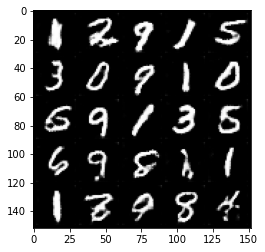

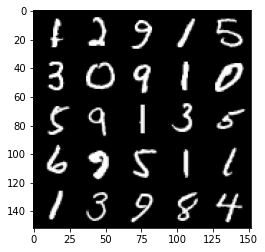

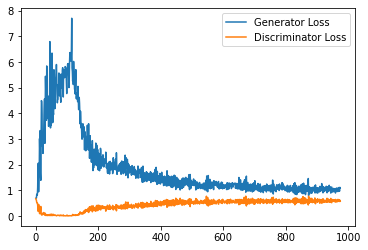

Step 20000: Generator loss: 1.0682902040481568, discriminator loss: 0.5889974703192711


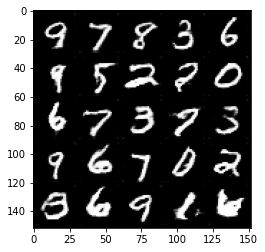

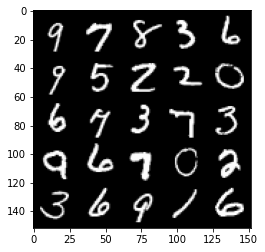

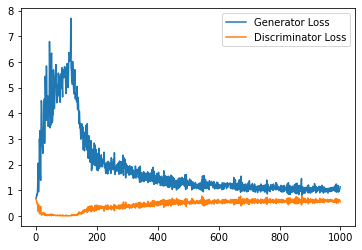

Step 20500: Generator loss: 0.9911758645772933, discriminator loss: 0.5993662632703781


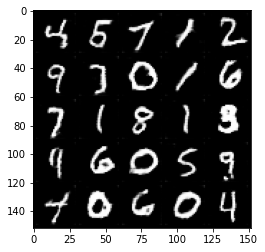

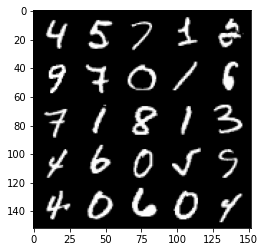

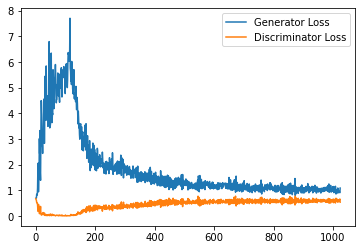

Step 21000: Generator loss: 1.0356297355890274, discriminator loss: 0.5962141698598862


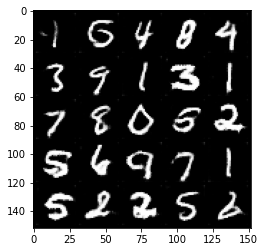

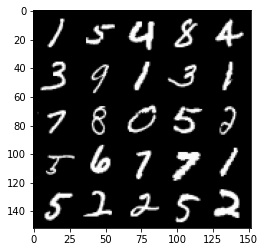

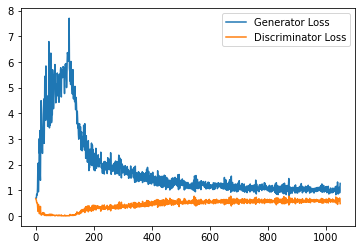

Step 21500: Generator loss: 1.0227446148395538, discriminator loss: 0.6046244072318077


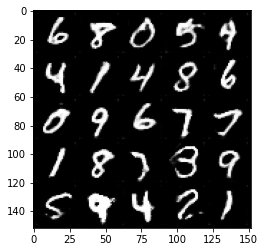

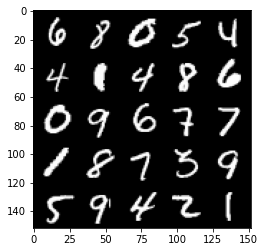

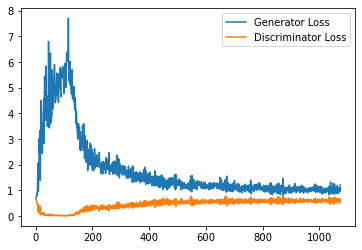

Step 22000: Generator loss: 1.0050655785799028, discriminator loss: 0.5995942094922065


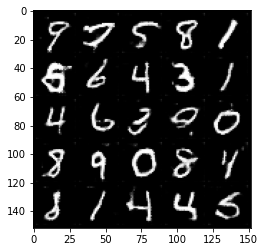

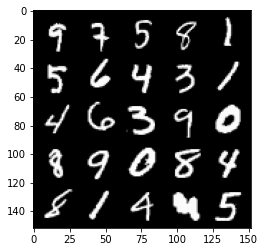

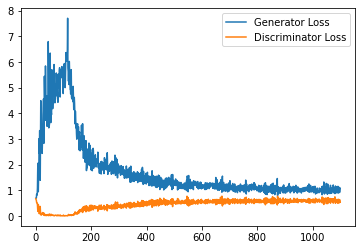

Step 22500: Generator loss: 0.98797245657444, discriminator loss: 0.6081325665116311


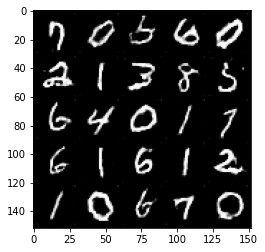

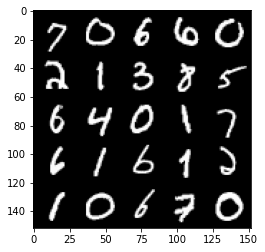

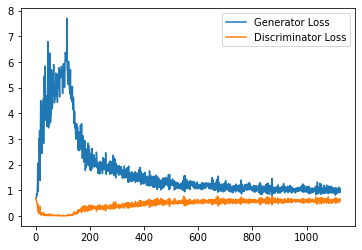

Step 23000: Generator loss: 1.0025200568437576, discriminator loss: 0.6063206123113632


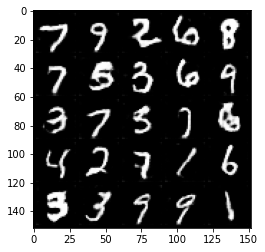

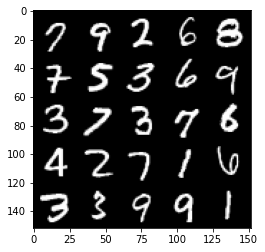

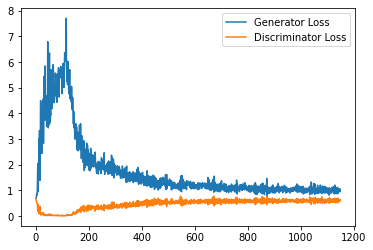

Step 23500: Generator loss: 0.9842342491149902, discriminator loss: 0.6099496765732765


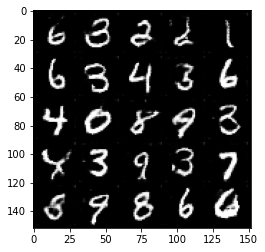

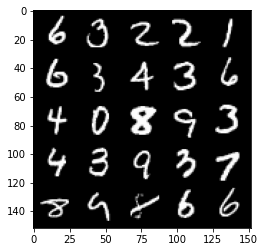

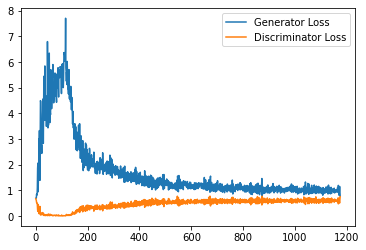

Step 24000: Generator loss: 0.9833766322135925, discriminator loss: 0.6011683550477028


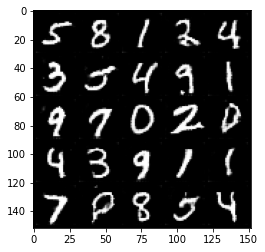

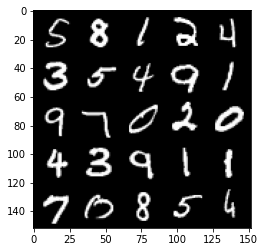

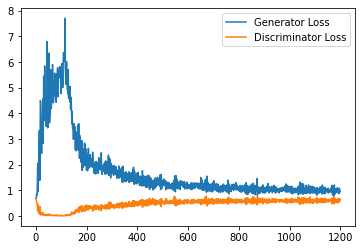

Step 24500: Generator loss: 0.9958396502733231, discriminator loss: 0.6033880335688591


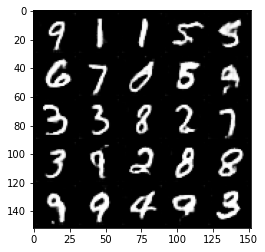

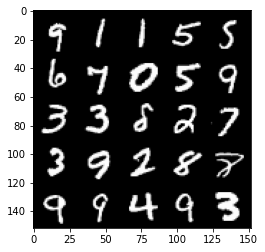

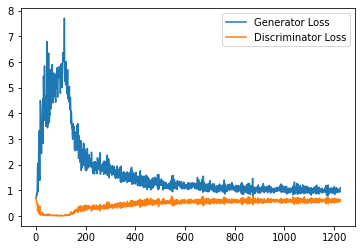

Step 25000: Generator loss: 0.9821121037006378, discriminator loss: 0.6111000028252601


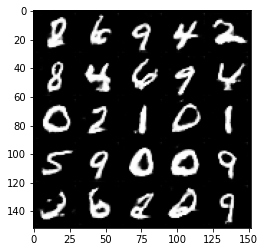

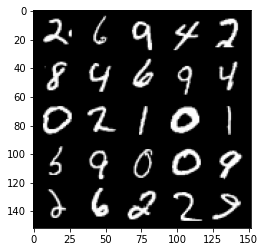

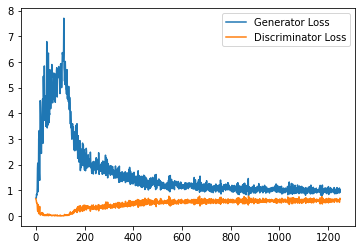

Step 25500: Generator loss: 1.0064514483213425, discriminator loss: 0.6039265462756157


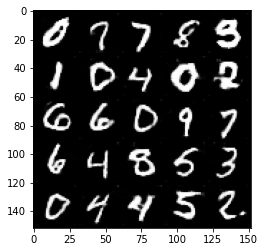

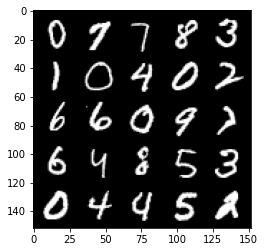

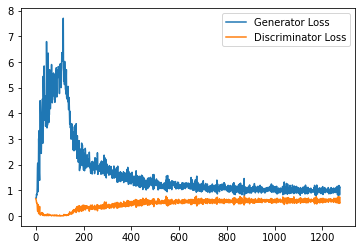

Step 26000: Generator loss: 0.9669451290369033, discriminator loss: 0.6052176219820976


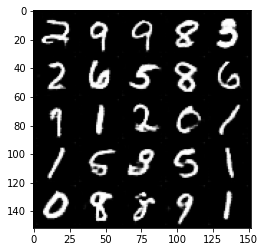

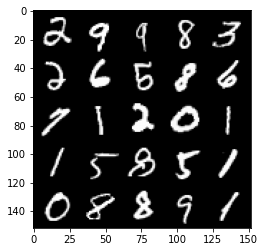

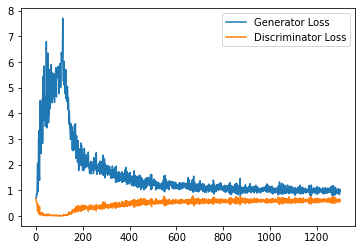

Step 26500: Generator loss: 0.9644418920278549, discriminator loss: 0.5986534320712089


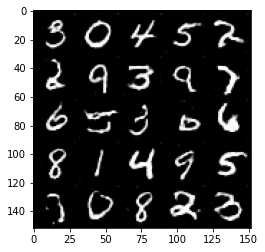

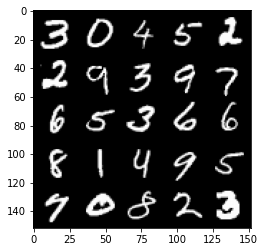

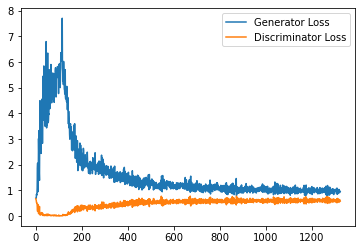

Step 27000: Generator loss: 0.9775305421352386, discriminator loss: 0.60506839376688


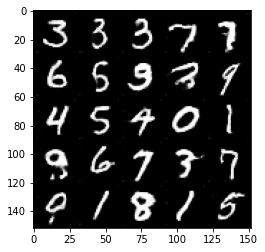

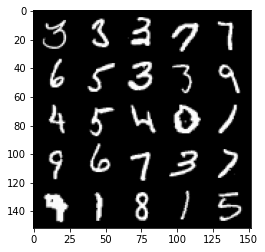

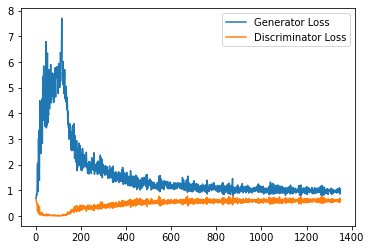

Step 27500: Generator loss: 0.9730172004699708, discriminator loss: 0.6054927718639374


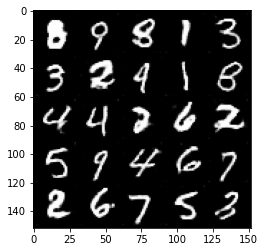

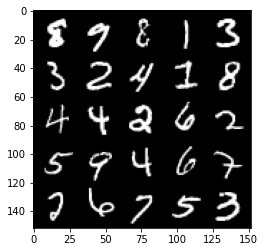

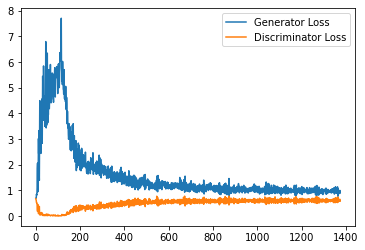

Step 28000: Generator loss: 0.9689864865541458, discriminator loss: 0.605420924603939


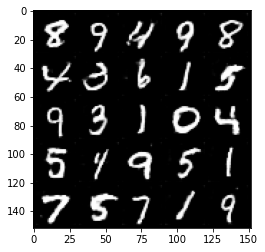

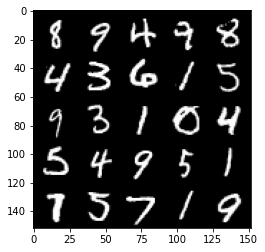

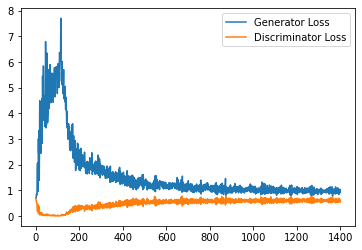

Step 28500: Generator loss: 0.9760263730287552, discriminator loss: 0.6057449978590012


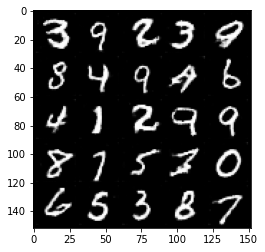

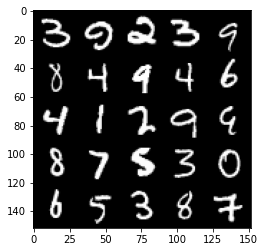

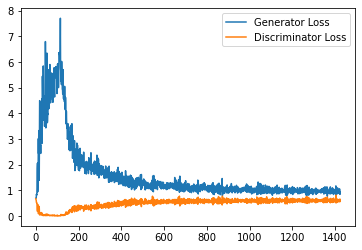

Step 29000: Generator loss: 0.9696443893909454, discriminator loss: 0.6062670841813087


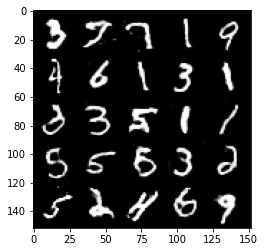

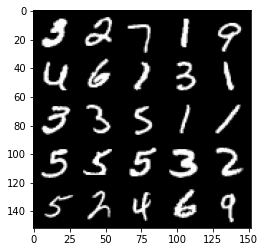

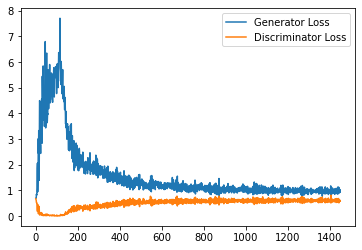

Step 29500: Generator loss: 0.9660189542770385, discriminator loss: 0.6113121287226677


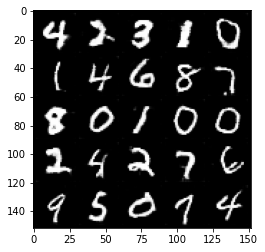

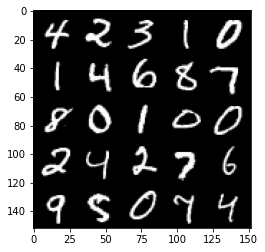

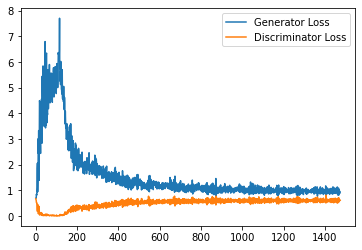

Step 30000: Generator loss: 0.965618014216423, discriminator loss: 0.6024366525411606


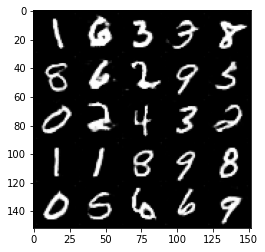

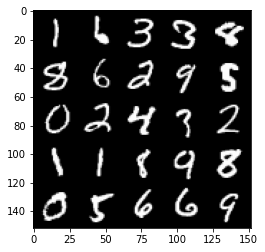

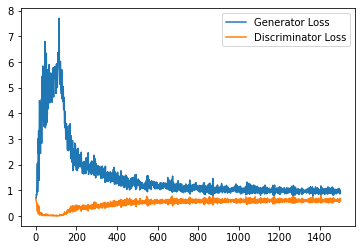

Step 30500: Generator loss: 0.9766912615299225, discriminator loss: 0.6032985624670982


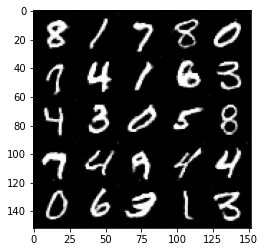

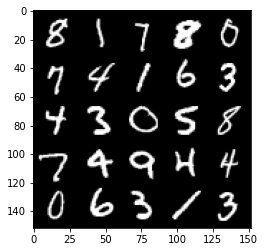

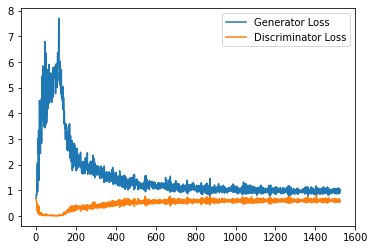

Step 31000: Generator loss: 0.9543573211431503, discriminator loss: 0.6057279360890389


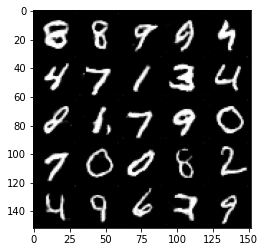

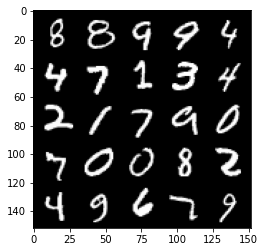

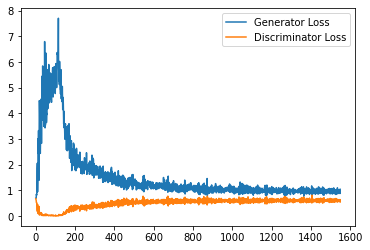

Step 31500: Generator loss: 0.967399134516716, discriminator loss: 0.6079388366937637


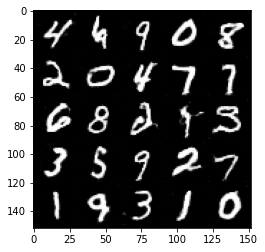

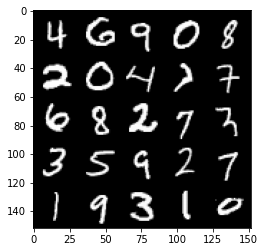

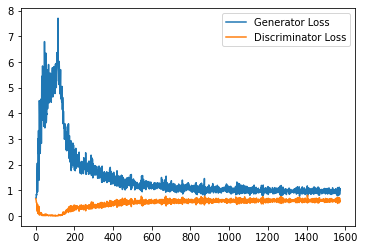

Step 32000: Generator loss: 0.9810788621902465, discriminator loss: 0.6008415680527687


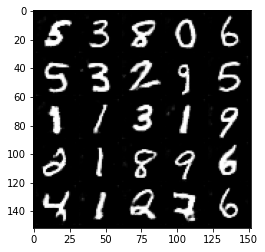

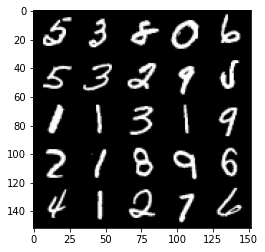

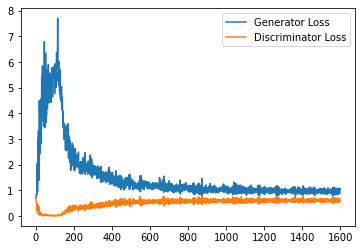

Step 32500: Generator loss: 0.9918036797046661, discriminator loss: 0.6019621278047562


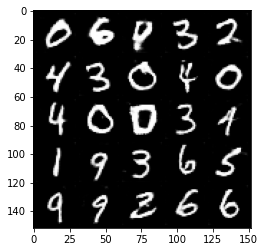

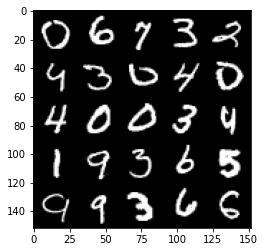

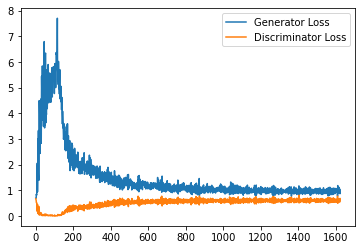

Step 33000: Generator loss: 0.9904011145830155, discriminator loss: 0.6008673247098922


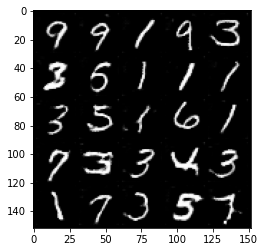

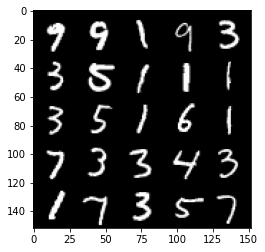

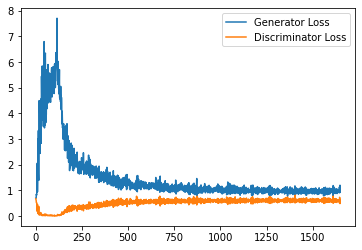

Step 33500: Generator loss: 0.9740456609725953, discriminator loss: 0.6031139313578605


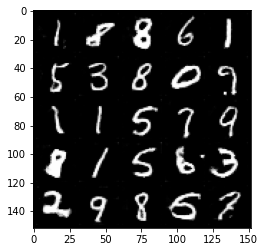

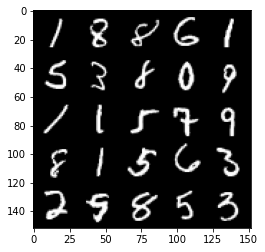

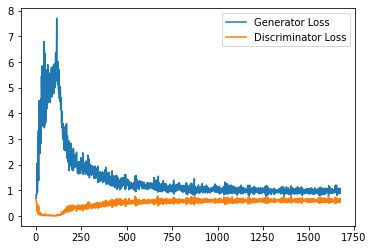

Step 34000: Generator loss: 0.970616305232048, discriminator loss: 0.5991955239772797


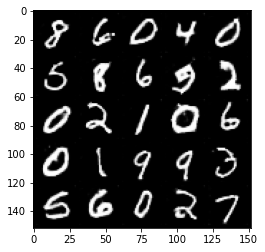

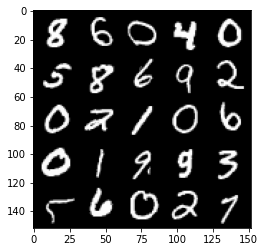

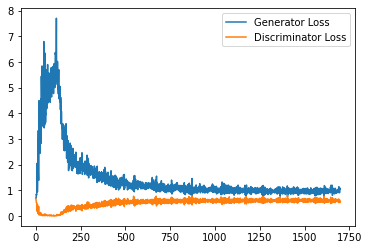

Step 34500: Generator loss: 0.9670907107591629, discriminator loss: 0.6027970552444458


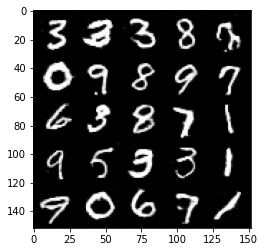

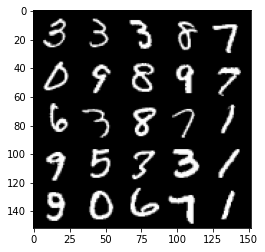

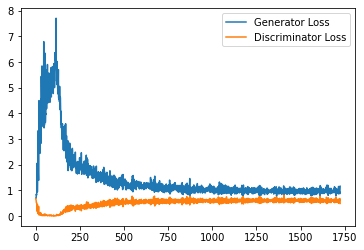

Step 35000: Generator loss: 0.9628734979629516, discriminator loss: 0.6030538273453713


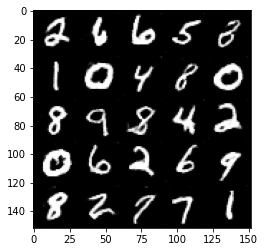

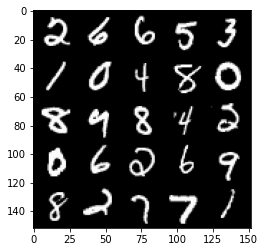

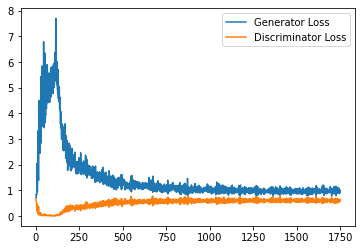

Step 35500: Generator loss: 0.9713360928297042, discriminator loss: 0.5910852809548378


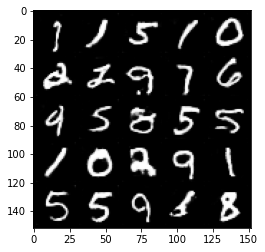

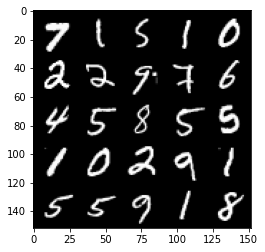

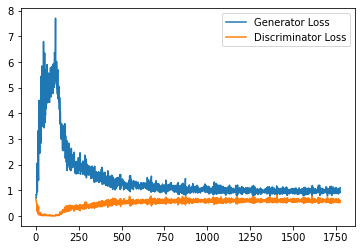

Step 36000: Generator loss: 0.9794091725349426, discriminator loss: 0.5977222884297371


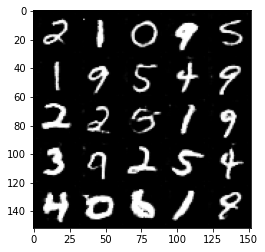

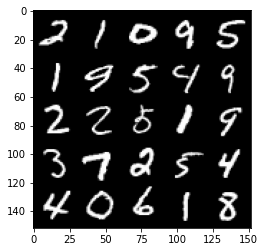

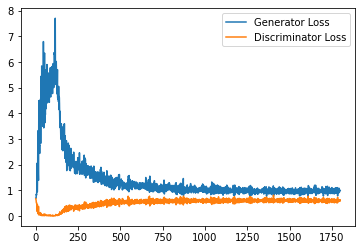

Step 36500: Generator loss: 0.965506646990776, discriminator loss: 0.597051896572113


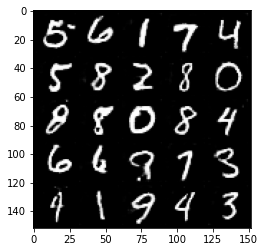

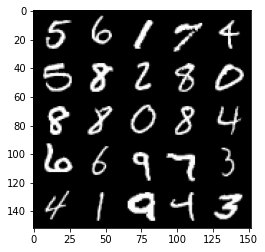

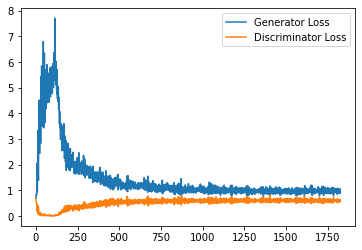

Step 37000: Generator loss: 0.9692626942396164, discriminator loss: 0.5964527065753937


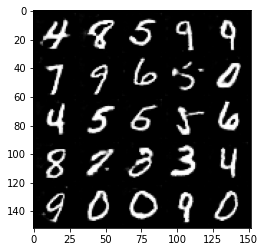

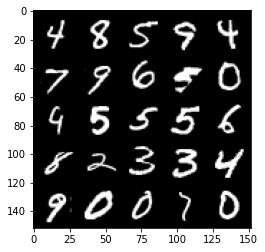

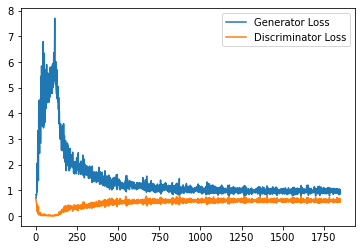

Step 37500: Generator loss: 0.9826056678295135, discriminator loss: 0.594636930167675


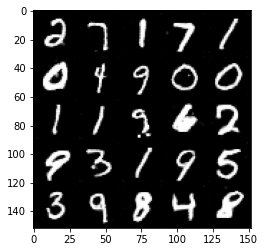

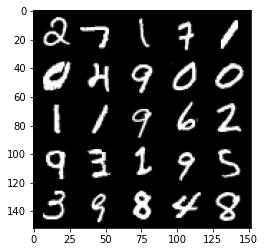

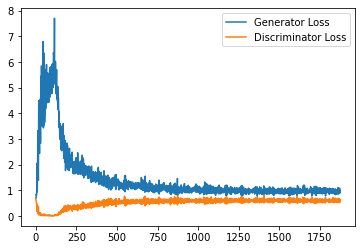

Step 38000: Generator loss: 1.006346517086029, discriminator loss: 0.590210054576397


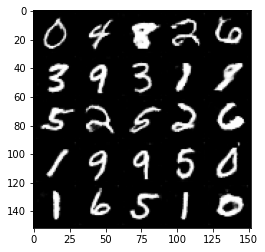

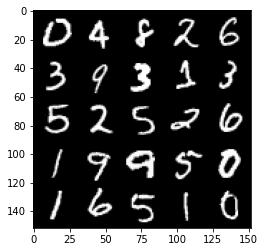

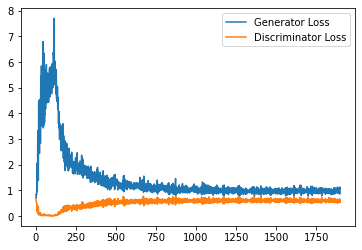

Step 38500: Generator loss: 0.9763523460626602, discriminator loss: 0.5951793873906136


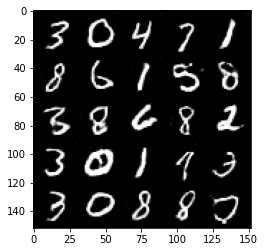

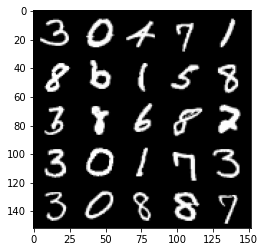

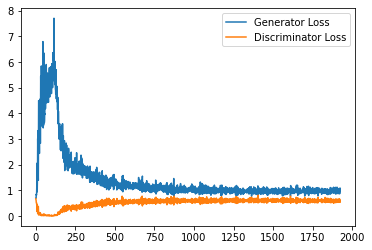

Step 39000: Generator loss: 0.9773963938951492, discriminator loss: 0.5966407153010368


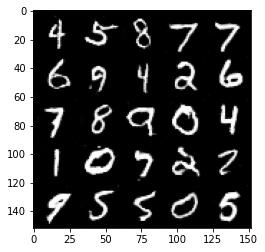

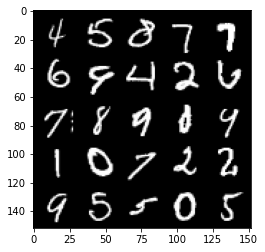

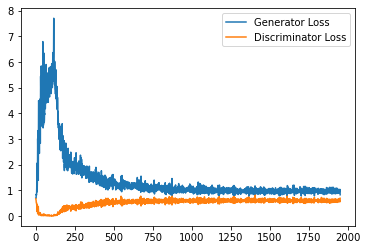

Step 39500: Generator loss: 0.9762501736879349, discriminator loss: 0.588865171790123


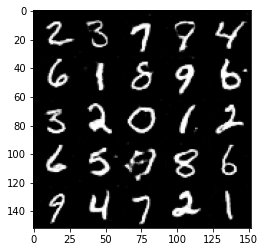

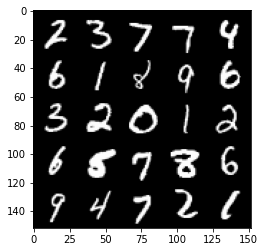

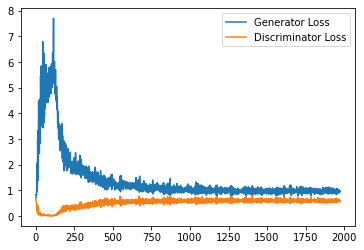

Step 40000: Generator loss: 0.9903118131160736, discriminator loss: 0.5972085628509521


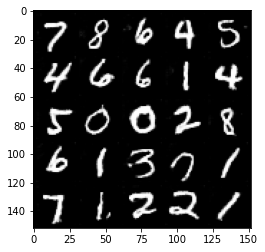

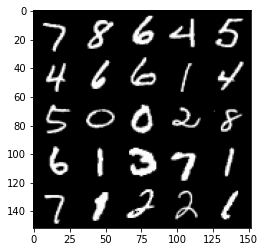

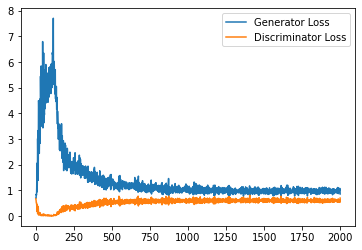

Step 40500: Generator loss: 1.0024859619140625, discriminator loss: 0.587945917904377


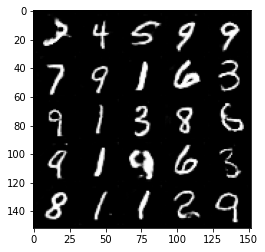

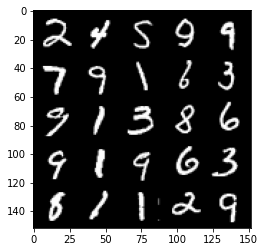

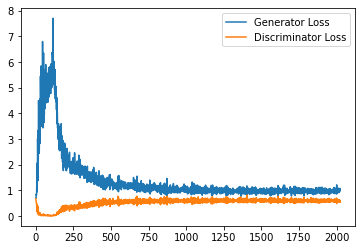

Step 41000: Generator loss: 0.9863967061042785, discriminator loss: 0.5951350709199905


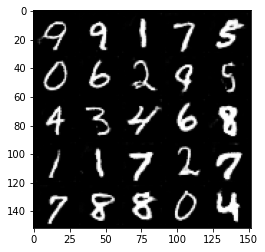

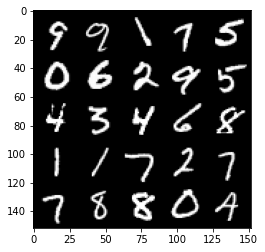

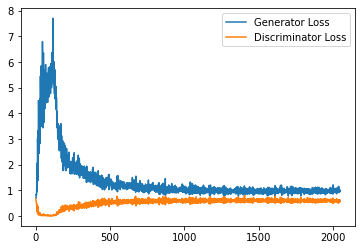

Step 41500: Generator loss: 0.9882720739841461, discriminator loss: 0.5897190382480622


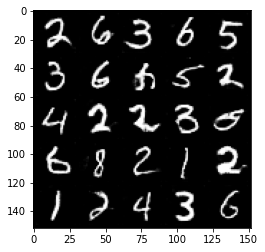

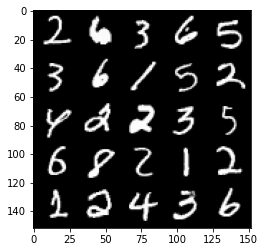

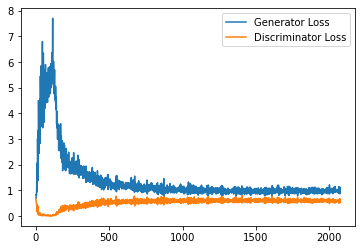

Step 42000: Generator loss: 0.9967059627771377, discriminator loss: 0.5830080530643463


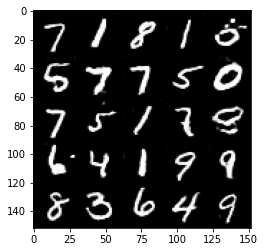

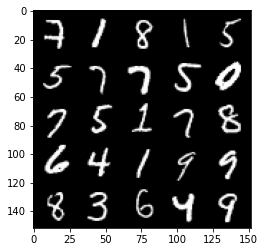

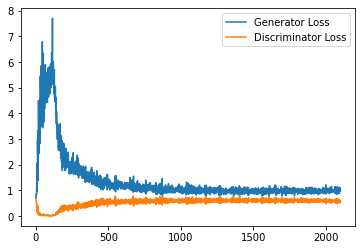

Step 42500: Generator loss: 1.0013884916305542, discriminator loss: 0.5888037775158882


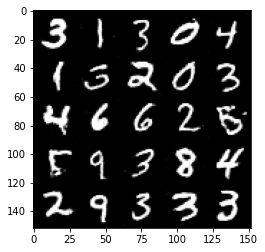

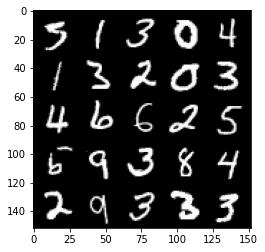

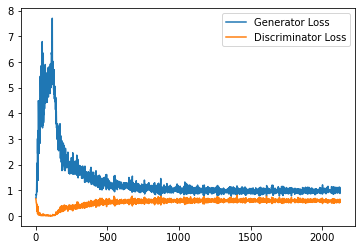

Step 43000: Generator loss: 1.0149312171936036, discriminator loss: 0.5892677202224731


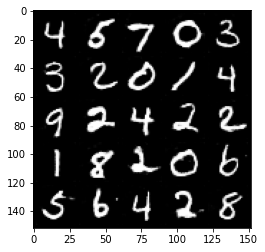

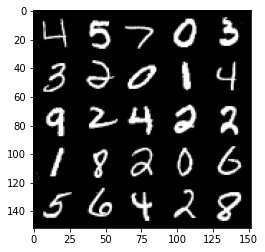

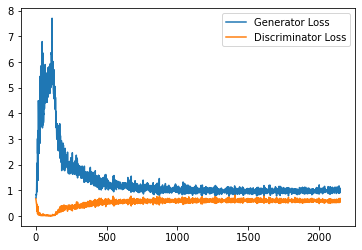

Step 43500: Generator loss: 1.0022362987995148, discriminator loss: 0.585331726193428


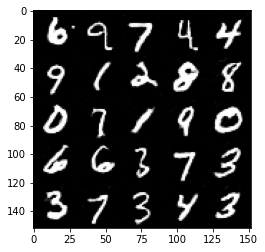

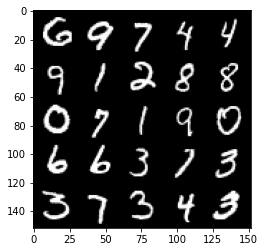

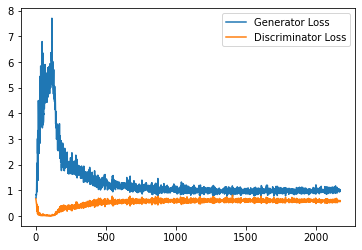

Step 44000: Generator loss: 0.9830761853456497, discriminator loss: 0.5907566124796867


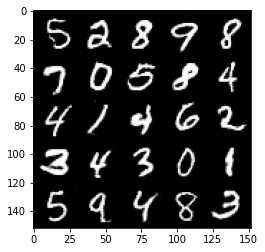

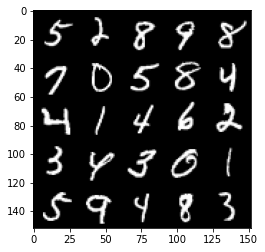

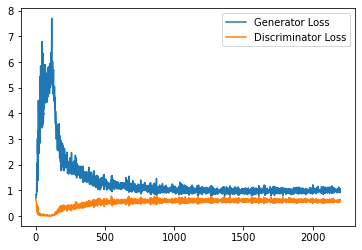

Step 44500: Generator loss: 0.9876731379032135, discriminator loss: 0.5899392873048782


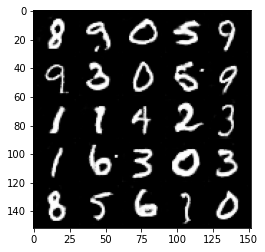

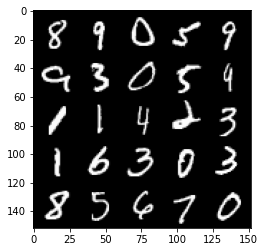

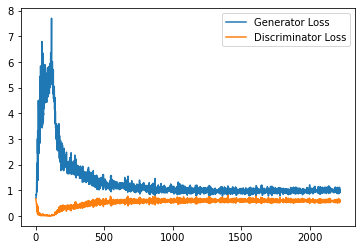

Step 45000: Generator loss: 0.9964810662269592, discriminator loss: 0.5882879337072372


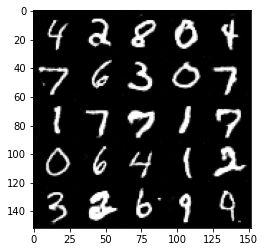

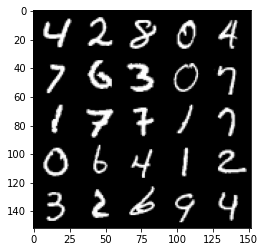

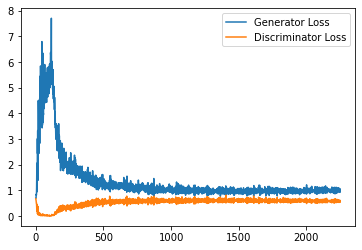

Step 45500: Generator loss: 0.9885292716026306, discriminator loss: 0.587701435983181


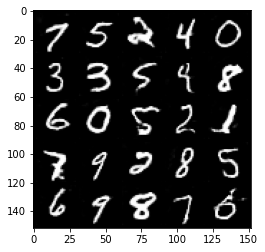

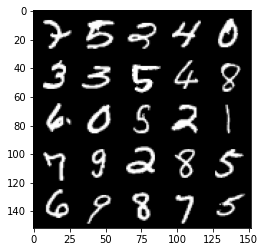

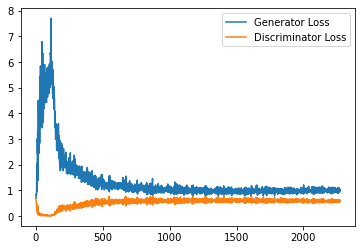

Step 46000: Generator loss: 1.0066516180038452, discriminator loss: 0.5870816964507103


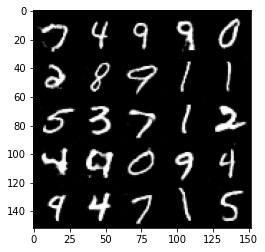

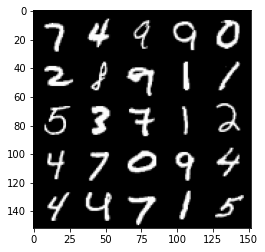

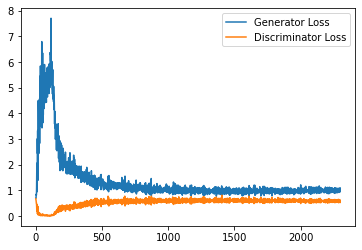

Step 46500: Generator loss: 1.0066803615093232, discriminator loss: 0.5900469199419022


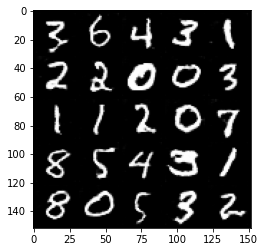

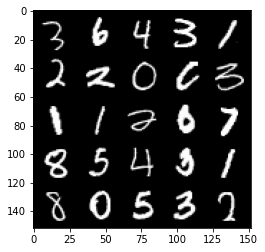

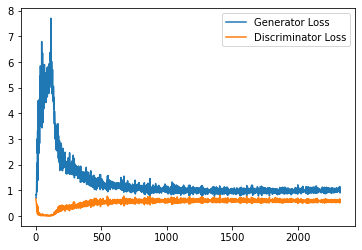

Step 47000: Generator loss: 0.996812056183815, discriminator loss: 0.5859895251989364


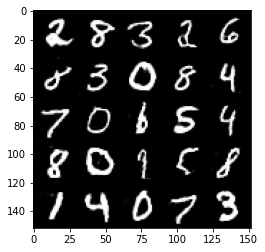

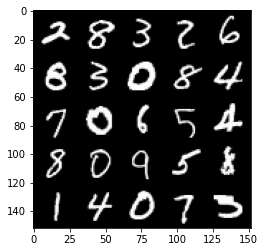

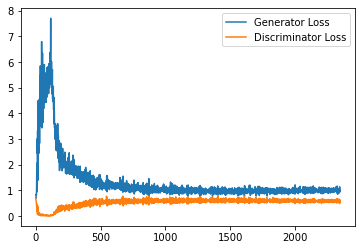

Step 47500: Generator loss: 1.007744955778122, discriminator loss: 0.5890420587062836


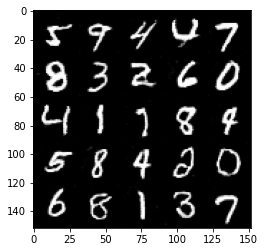

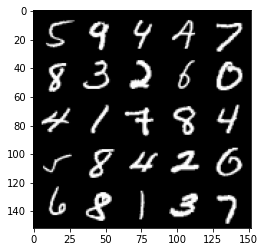

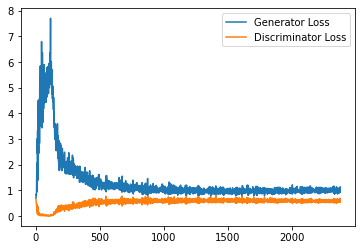

Step 48000: Generator loss: 0.9989004291296005, discriminator loss: 0.5826450577974319


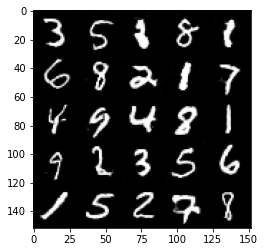

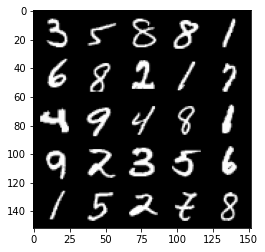

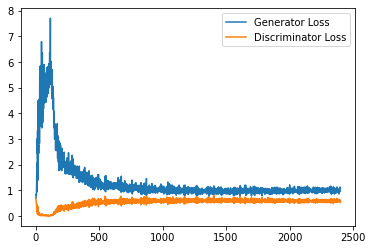

Step 48500: Generator loss: 1.0015314575433731, discriminator loss: 0.5905862140655518


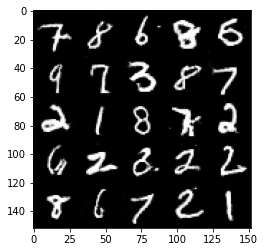

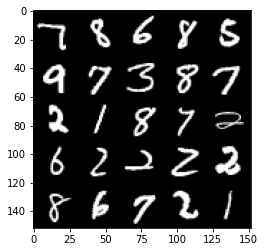

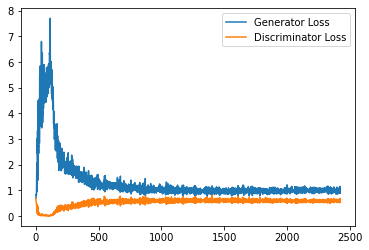

Step 49000: Generator loss: 1.0023741730451583, discriminator loss: 0.5865086619257927


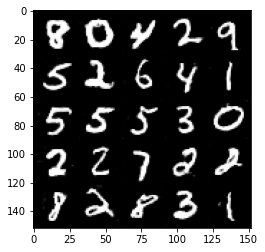

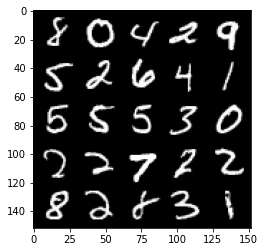

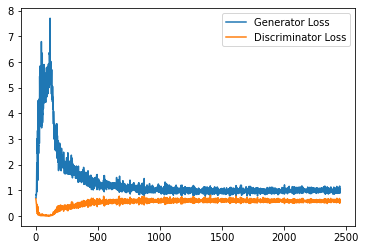

Step 49500: Generator loss: 1.0302740128040313, discriminator loss: 0.5857500939965248


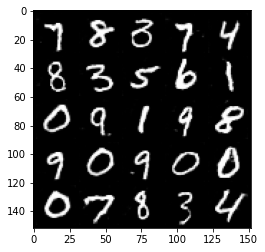

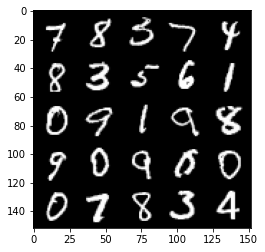

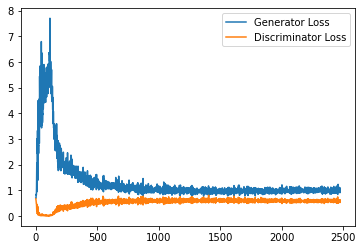

Step 50000: Generator loss: 1.0023000857830047, discriminator loss: 0.5900027794241905


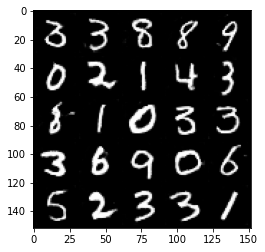

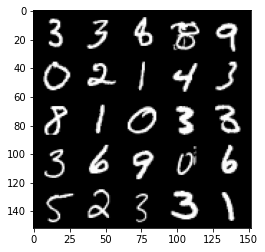

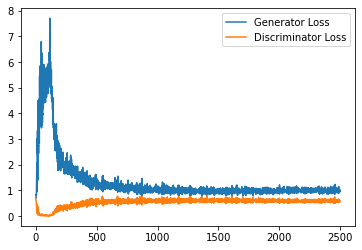

Step 50500: Generator loss: 1.0008818187713624, discriminator loss: 0.589031045794487


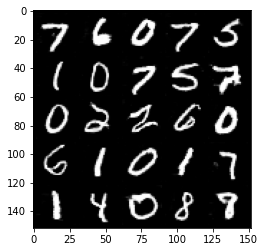

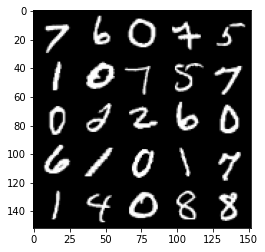

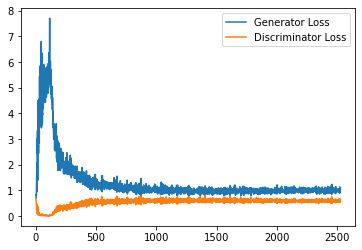

Step 51000: Generator loss: 1.0096163215637206, discriminator loss: 0.5863738428354264


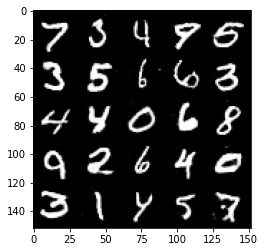

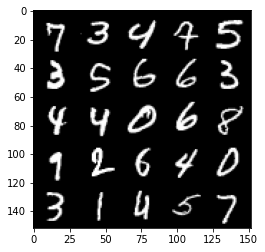

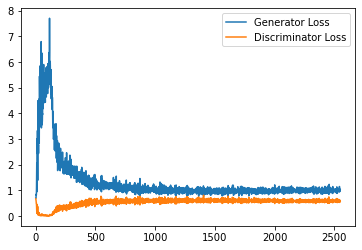

Step 51500: Generator loss: 1.0130652679204941, discriminator loss: 0.5934979221224785


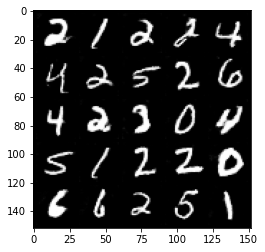

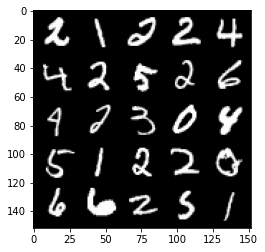

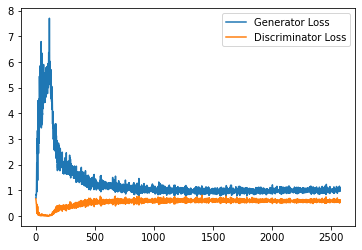

Step 52000: Generator loss: 1.0211573126316071, discriminator loss: 0.5811219261884689


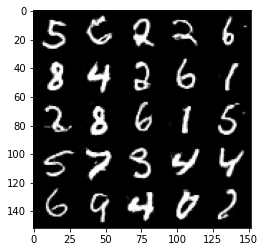

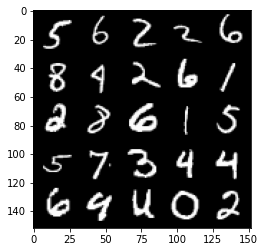

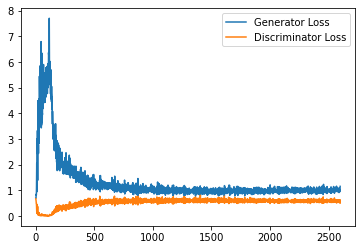

Step 52500: Generator loss: 1.022667064666748, discriminator loss: 0.5840195994973183


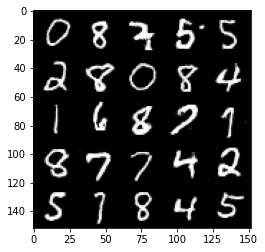

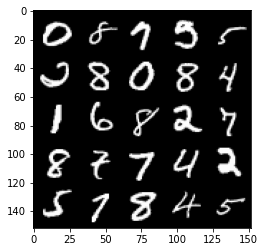

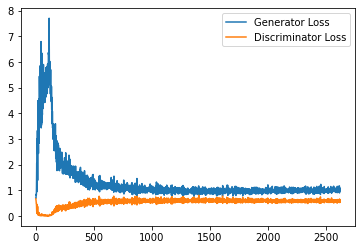

Step 53000: Generator loss: 0.9998760956525803, discriminator loss: 0.5866579806804657


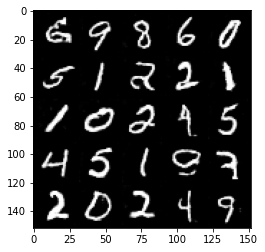

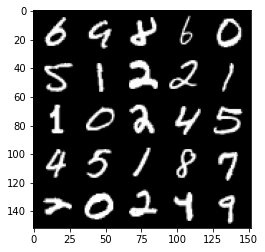

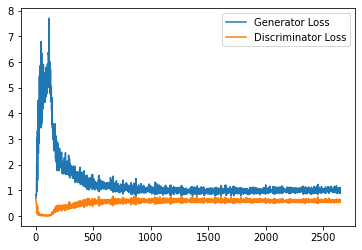

Step 53500: Generator loss: 1.0064582495689391, discriminator loss: 0.5862244282960891


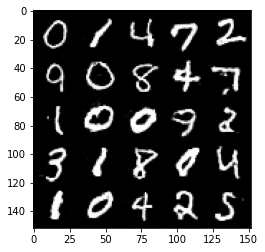

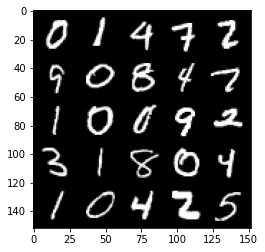

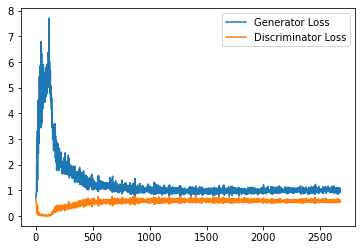

Step 54000: Generator loss: 1.039964760184288, discriminator loss: 0.5841937139034271


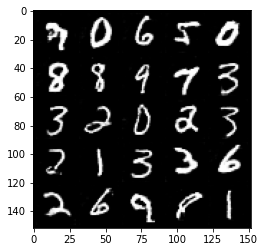

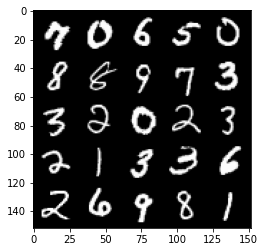

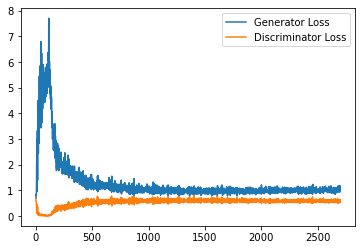

Step 54500: Generator loss: 1.0381265177726746, discriminator loss: 0.5918932666778565


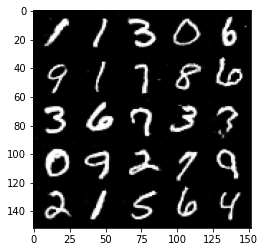

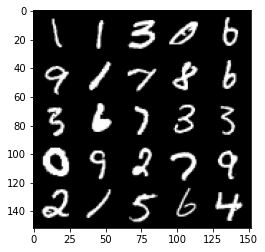

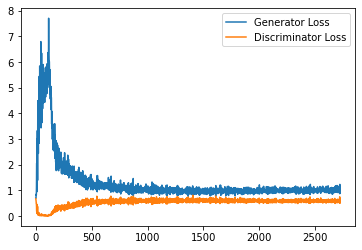

Step 55000: Generator loss: 1.0189923230409623, discriminator loss: 0.5876728558540344


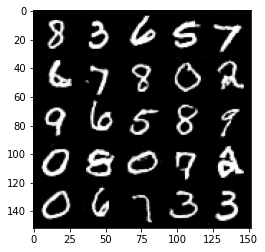

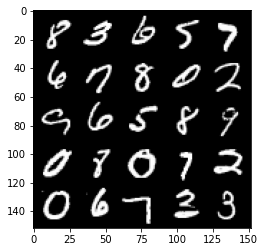

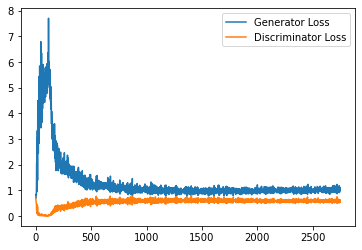

Step 55500: Generator loss: 1.0106177114248276, discriminator loss: 0.5917250189781189


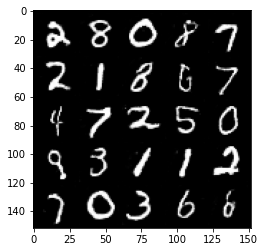

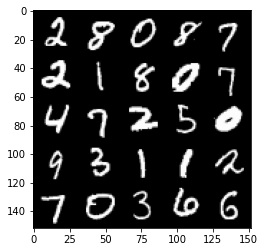

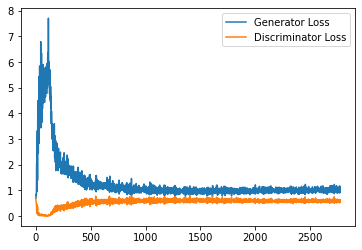

Step 56000: Generator loss: 1.0013083690404891, discriminator loss: 0.5901830407977104


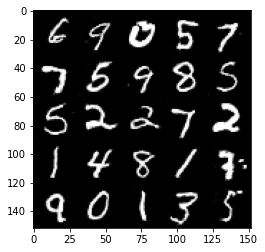

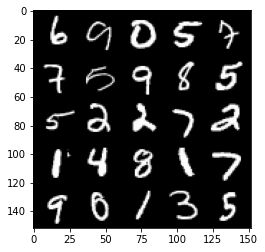

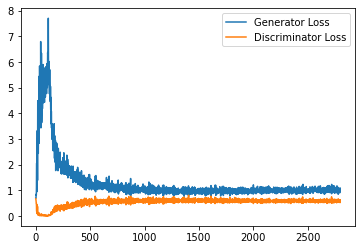

Step 56500: Generator loss: 1.0201672904491426, discriminator loss: 0.5881494338512421


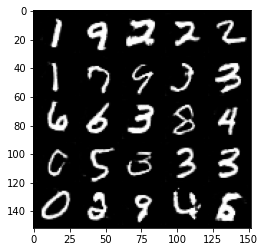

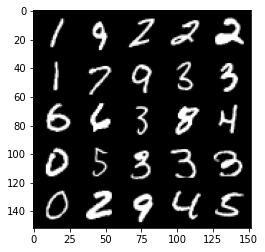

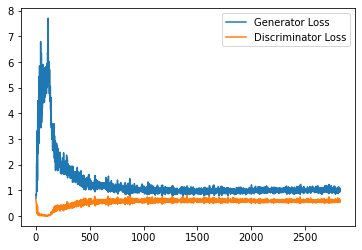

Step 57000: Generator loss: 1.030092028260231, discriminator loss: 0.5929016805291176


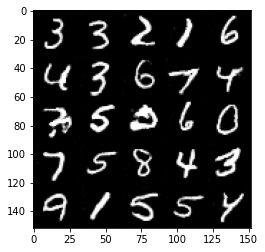

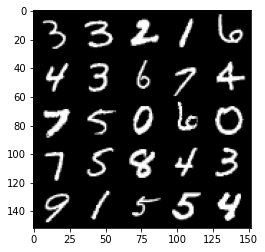

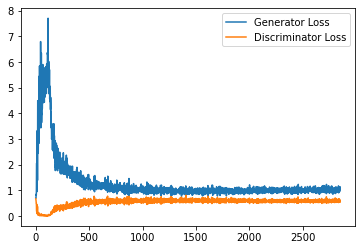

Step 57500: Generator loss: 1.0036201125383377, discriminator loss: 0.5982970589995384


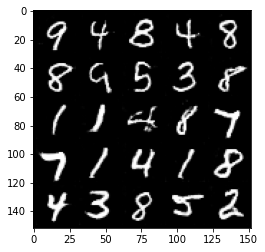

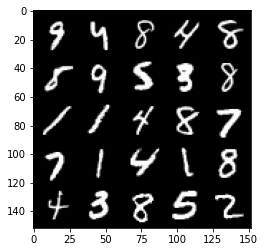

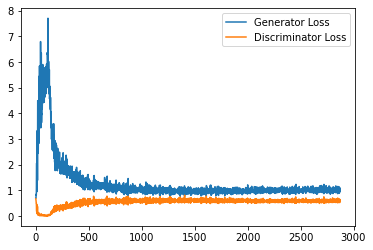

Step 58000: Generator loss: 1.001035149693489, discriminator loss: 0.5936112790107727


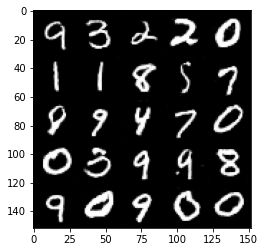

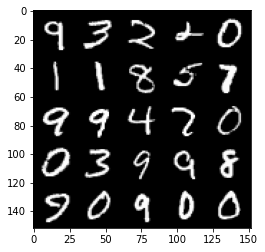

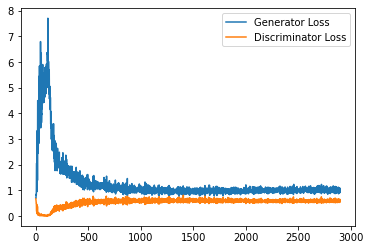

Step 58500: Generator loss: 1.0092877057790757, discriminator loss: 0.5924327551722527


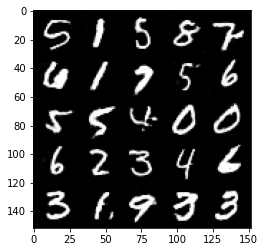

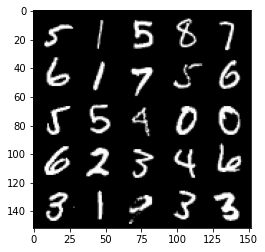

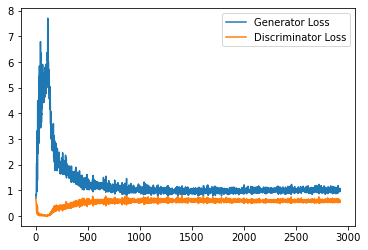

Step 59000: Generator loss: 1.0019623401165008, discriminator loss: 0.5945347483754158


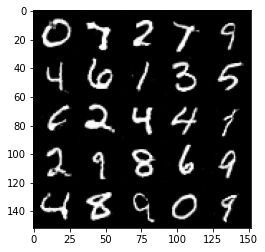

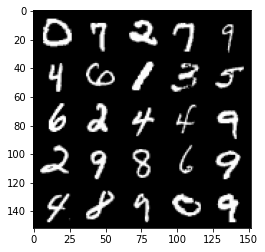

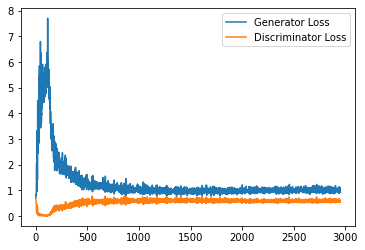

Step 59500: Generator loss: 0.993244140803814, discriminator loss: 0.5981142715811729


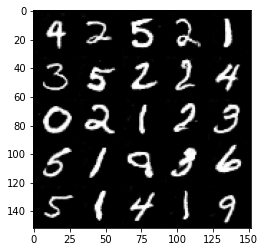

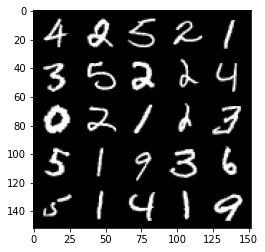

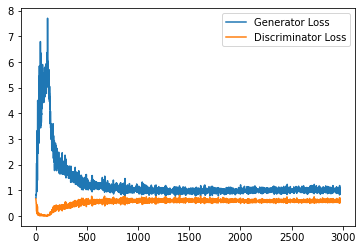

Step 60000: Generator loss: 1.0056219084262847, discriminator loss: 0.597480584681034


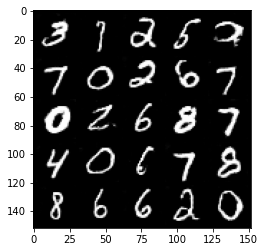

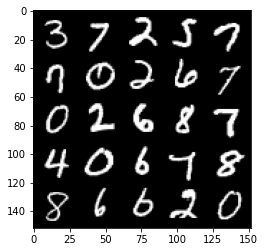

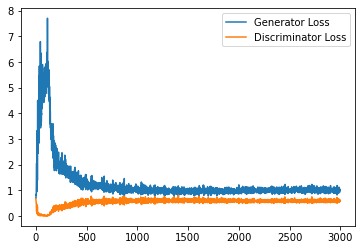

Step 60500: Generator loss: 1.0150794442892075, discriminator loss: 0.5952868802547455


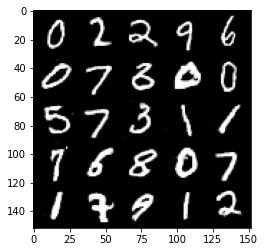

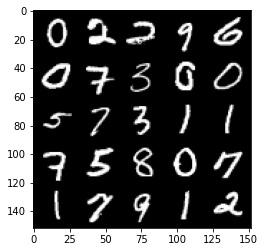

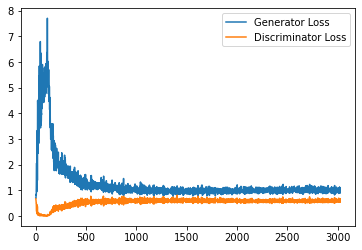

Step 61000: Generator loss: 0.9943978306055069, discriminator loss: 0.5994957272410393


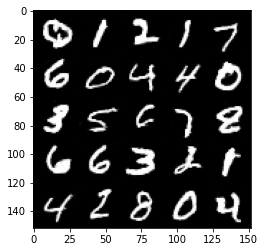

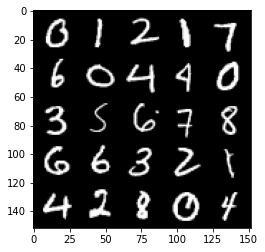

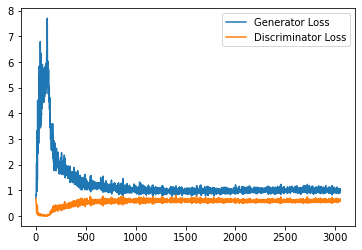

Step 61500: Generator loss: 0.996704889535904, discriminator loss: 0.5979993063807487


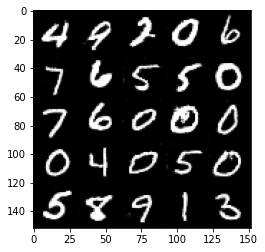

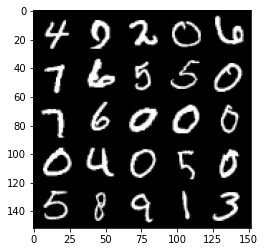

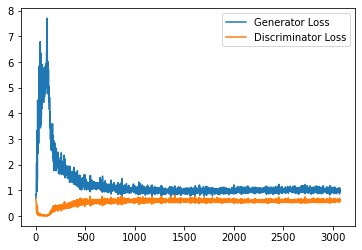

Step 62000: Generator loss: 0.9984962326288224, discriminator loss: 0.596433573782444


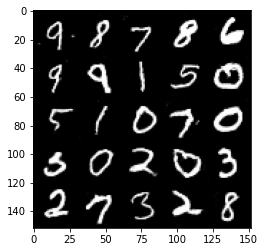

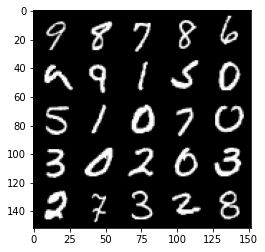

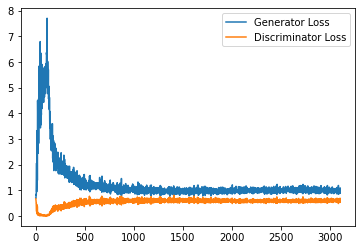

Step 62500: Generator loss: 0.9999439622163773, discriminator loss: 0.5988894860744476


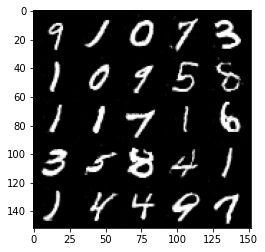

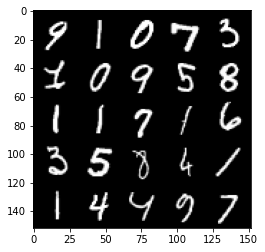

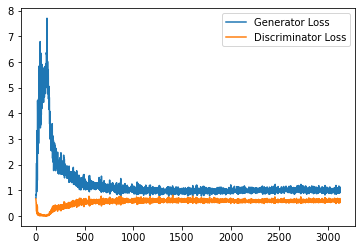

Step 63000: Generator loss: 0.9875062972307205, discriminator loss: 0.6003846669793129


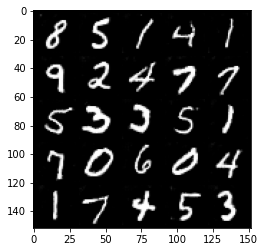

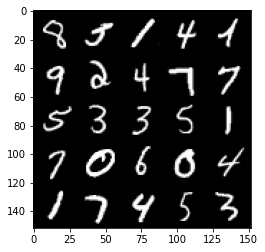

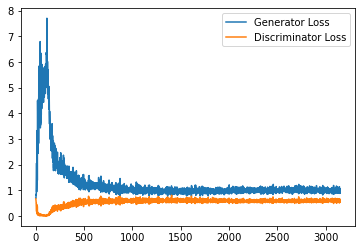

Step 63500: Generator loss: 0.9949660894870758, discriminator loss: 0.5976938245892525


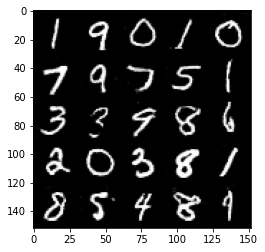

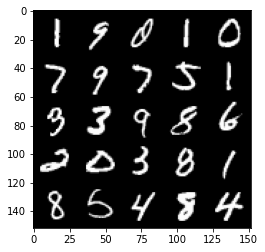

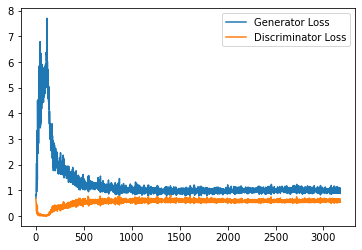

Step 64000: Generator loss: 0.97596892786026, discriminator loss: 0.6018809953927994


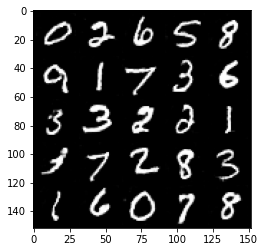

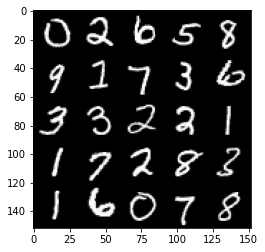

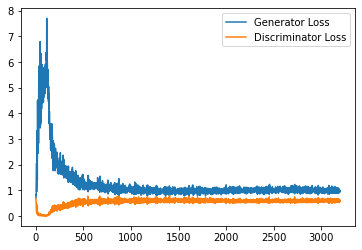

Step 64500: Generator loss: 0.9870077891349792, discriminator loss: 0.6000278162360191


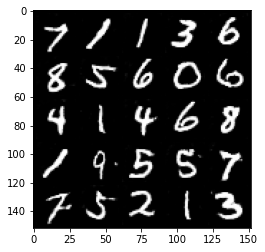

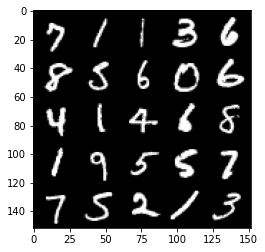

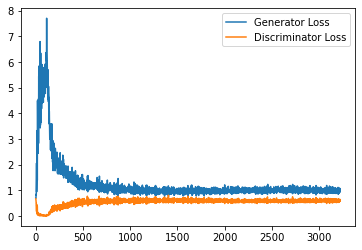

Step 65000: Generator loss: 0.9853330969214439, discriminator loss: 0.6085981723666191


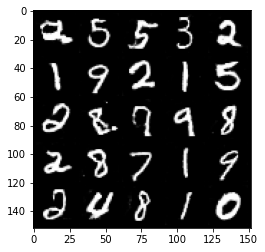

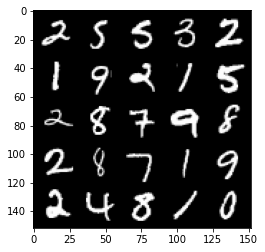

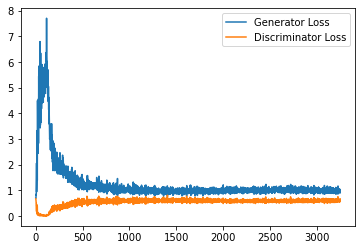

Step 65500: Generator loss: 0.9831943581104279, discriminator loss: 0.6017528823018075


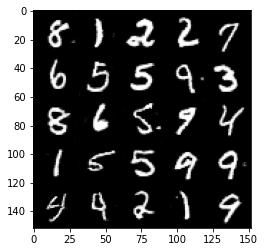

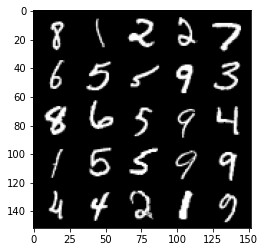

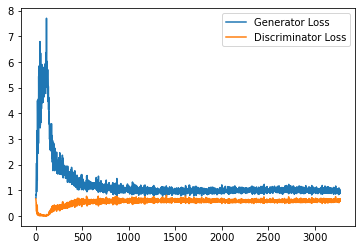

Step 66000: Generator loss: 1.0001031037569046, discriminator loss: 0.6035155893564225


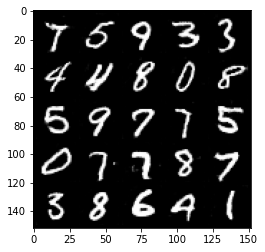

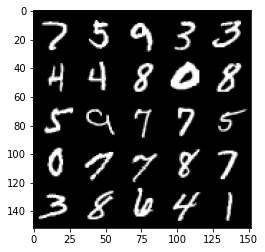

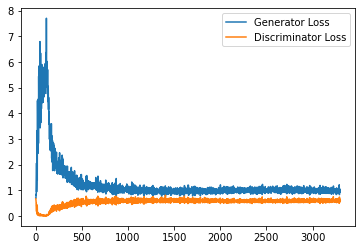

Step 66500: Generator loss: 0.9876251307725906, discriminator loss: 0.6025719988942146


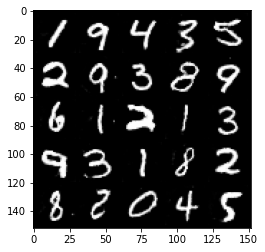

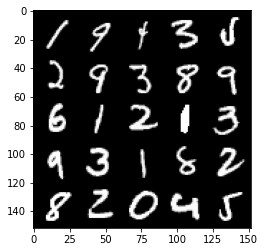

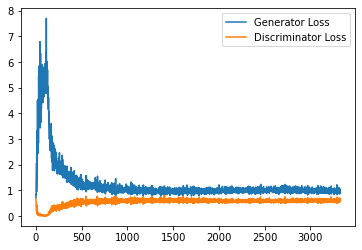

Step 67000: Generator loss: 0.992243489742279, discriminator loss: 0.6050505474805832


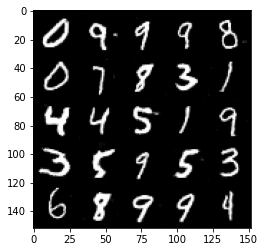

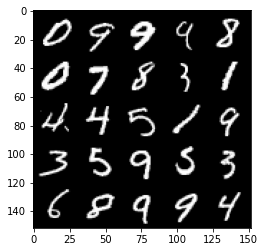

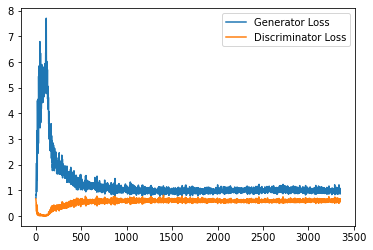

Step 67500: Generator loss: 0.9799210696220398, discriminator loss: 0.6044318259358407


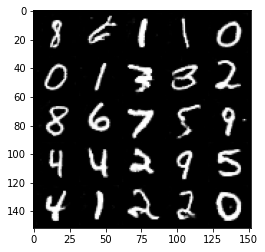

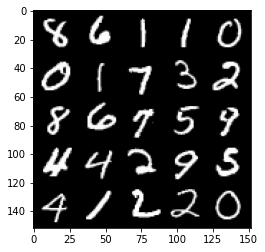

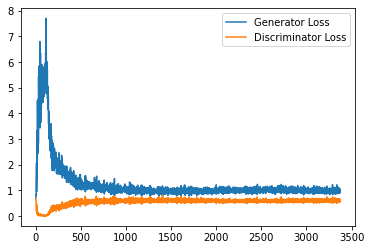

Step 68000: Generator loss: 0.972703236579895, discriminator loss: 0.6036550832390786


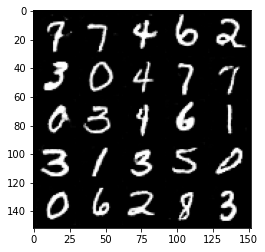

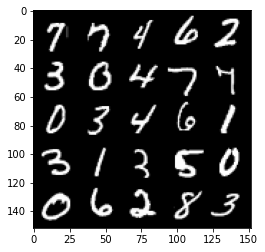

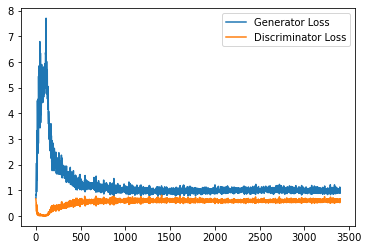

Step 68500: Generator loss: 1.0033785910606385, discriminator loss: 0.6064355483651162


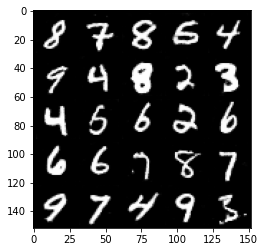

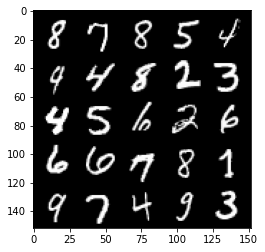

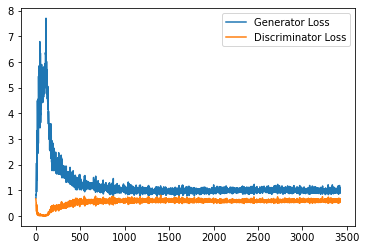

Step 69000: Generator loss: 0.9706701557636261, discriminator loss: 0.608959209561348


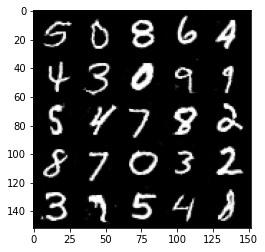

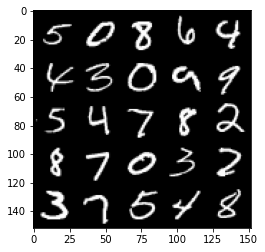

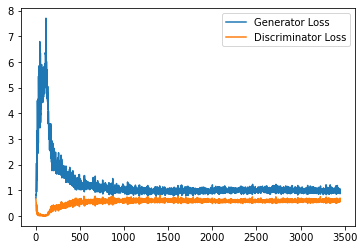

Step 69500: Generator loss: 0.9868852022886276, discriminator loss: 0.6080463893413544


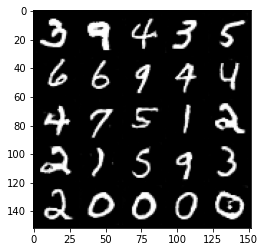

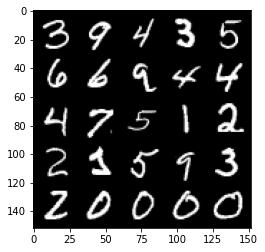

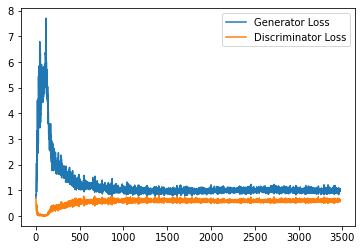

Step 70000: Generator loss: 0.9682311259508133, discriminator loss: 0.6136663509011269


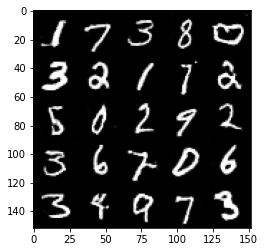

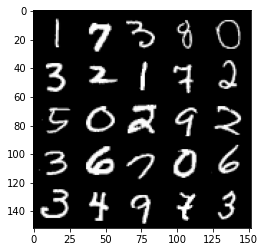

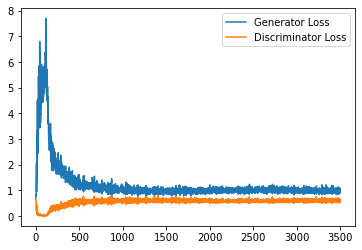

Step 70500: Generator loss: 0.9666651282310486, discriminator loss: 0.60539035820961


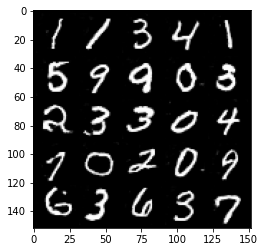

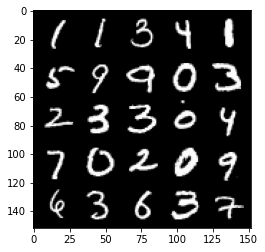

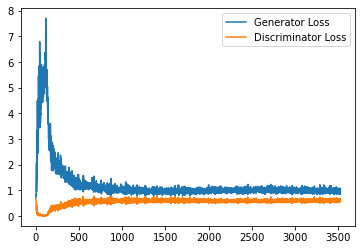

Step 71000: Generator loss: 0.9587705128192902, discriminator loss: 0.6133206968307495


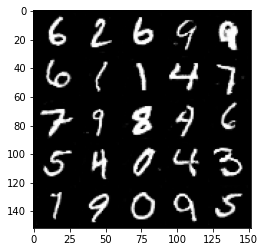

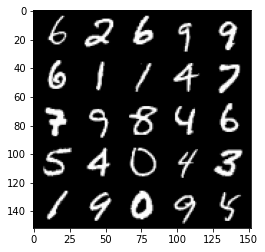

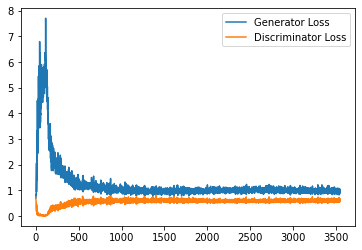

Step 71500: Generator loss: 0.9857750982046127, discriminator loss: 0.6098639075756073


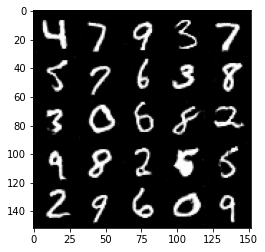

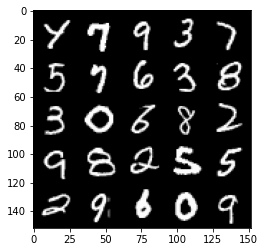

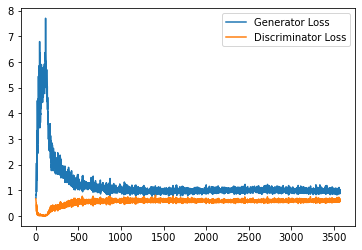

Step 72000: Generator loss: 0.9662056105136871, discriminator loss: 0.6056889101862908


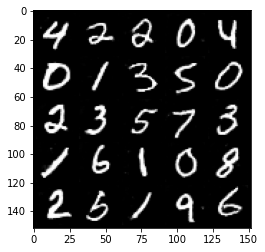

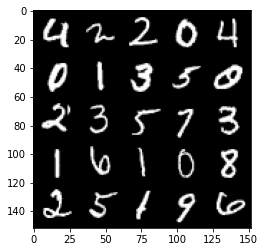

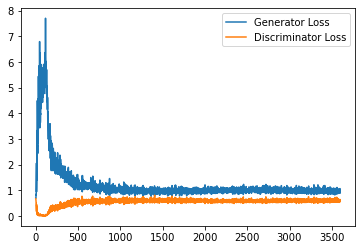

Step 72500: Generator loss: 0.9587171807289123, discriminator loss: 0.6099074259400368


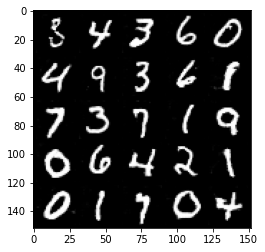

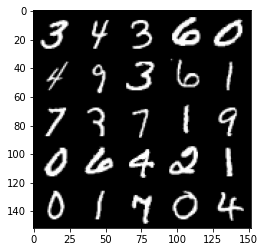

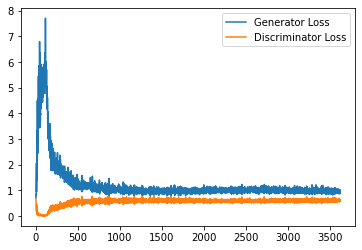

Step 73000: Generator loss: 0.9588384330272675, discriminator loss: 0.6095430238246917


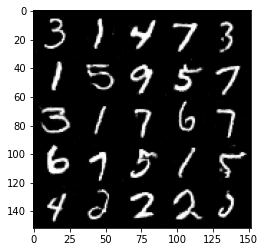

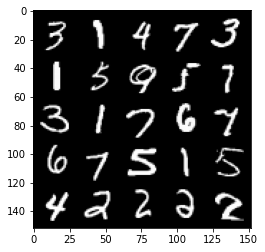

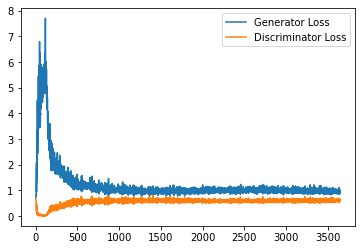

Step 73500: Generator loss: 0.9795956678390503, discriminator loss: 0.6094582722187042


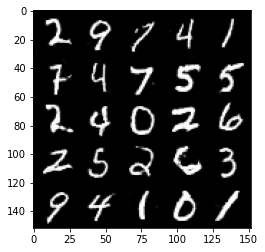

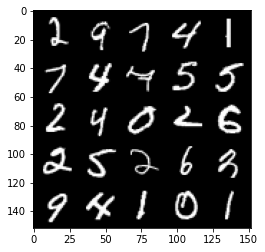

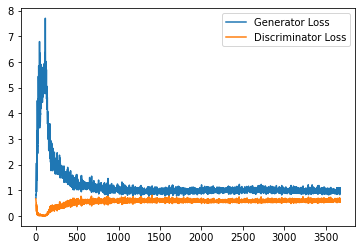

Step 74000: Generator loss: 0.9710589076280594, discriminator loss: 0.6141779808998108


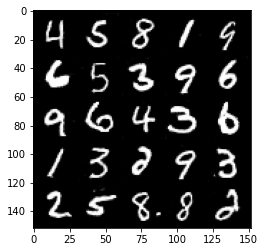

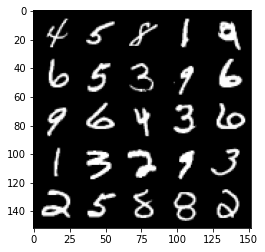

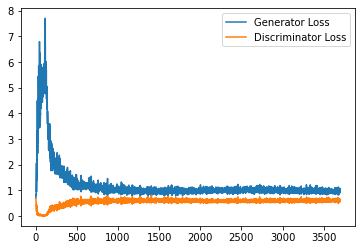

Step 74500: Generator loss: 0.9811151354908944, discriminator loss: 0.6131541135907174


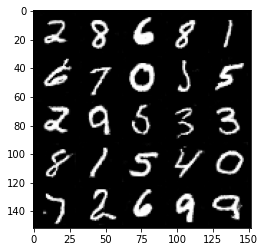

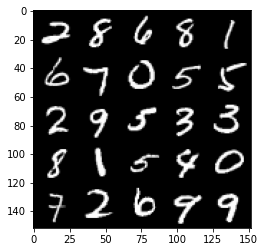

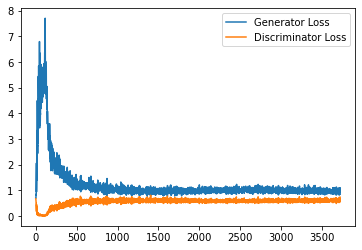

Step 75000: Generator loss: 0.9665651309490204, discriminator loss: 0.6101514257192612


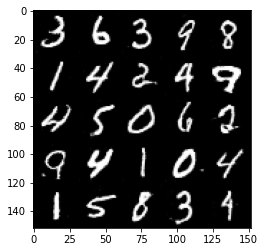

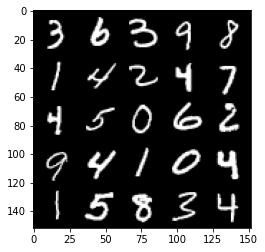

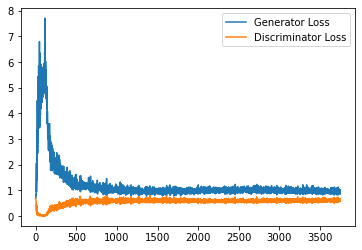

Step 75500: Generator loss: 0.9574931823015213, discriminator loss: 0.6095527357459068


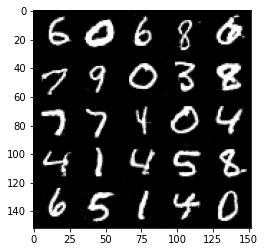

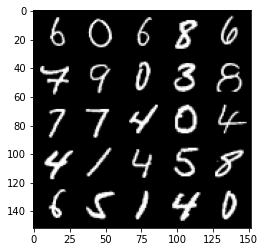

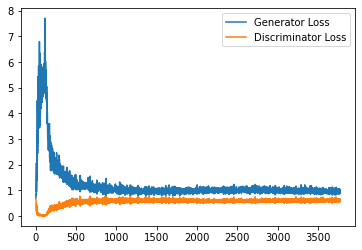

Step 76000: Generator loss: 0.956268329501152, discriminator loss: 0.6153049966692925


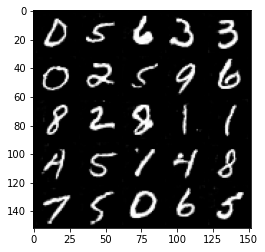

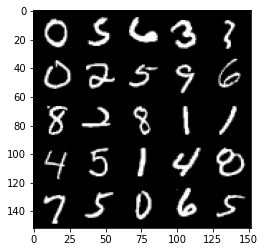

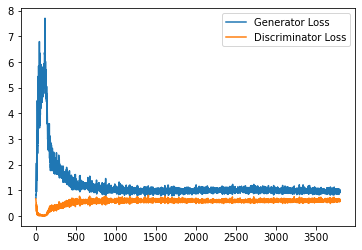

Step 76500: Generator loss: 0.9571218836307526, discriminator loss: 0.6116931982636452


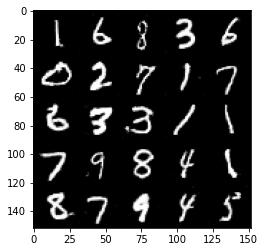

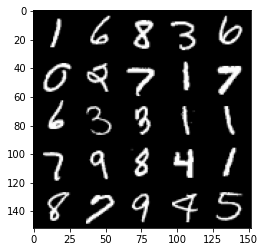

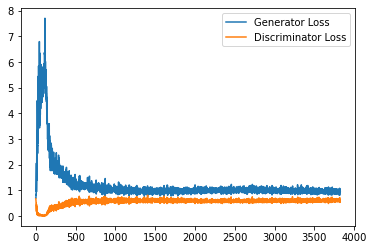

Step 77000: Generator loss: 0.9573084523677826, discriminator loss: 0.611050121486187


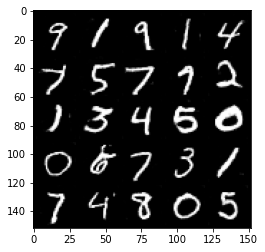

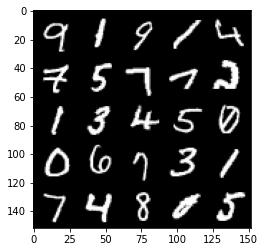

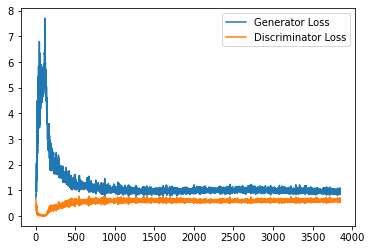

Step 77500: Generator loss: 0.9696326236724854, discriminator loss: 0.6186220428943634


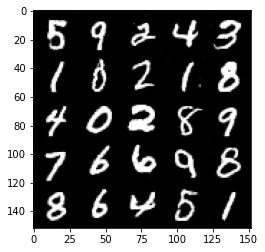

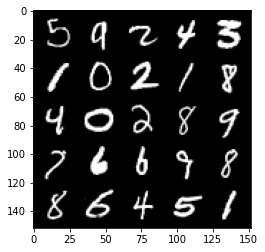

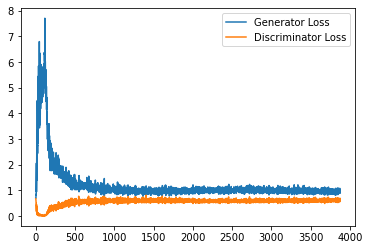

Step 78000: Generator loss: 0.9630939414501191, discriminator loss: 0.6080889158248901


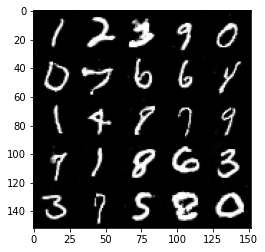

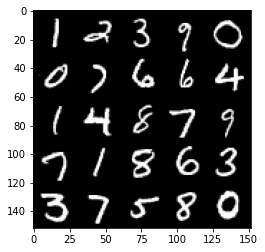

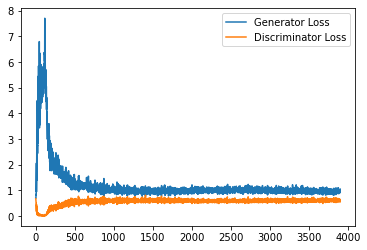

Step 78500: Generator loss: 0.9607326477766037, discriminator loss: 0.6128436022996903


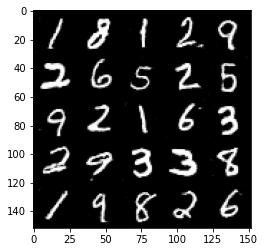

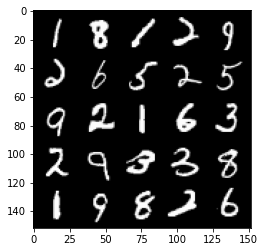

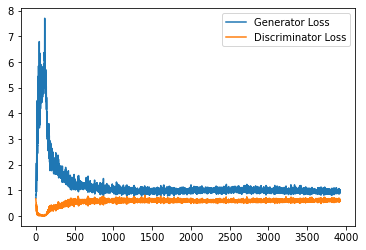

Step 79000: Generator loss: 0.9627038924694061, discriminator loss: 0.6200349597334862


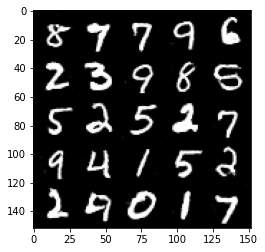

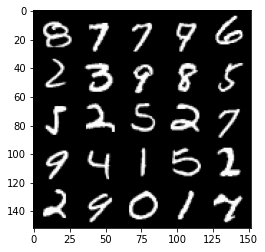

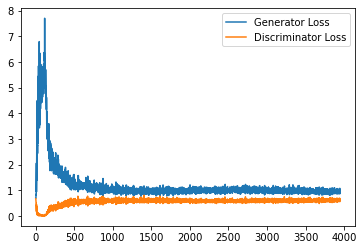

Step 79500: Generator loss: 0.942063388466835, discriminator loss: 0.6121799449920654


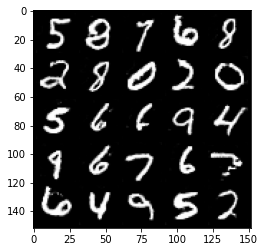

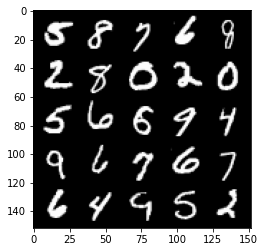

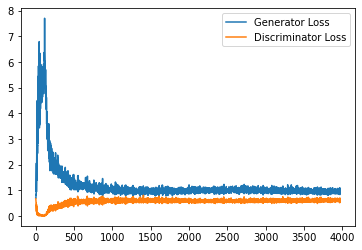

Step 80000: Generator loss: 0.9720599595308304, discriminator loss: 0.6147052671313286


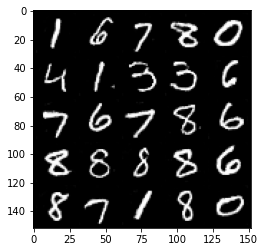

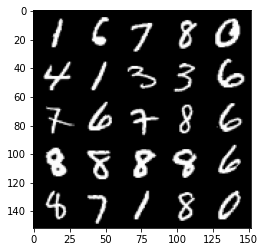

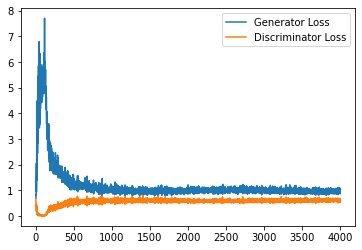

Step 80500: Generator loss: 0.9558175723552704, discriminator loss: 0.6099973534345626


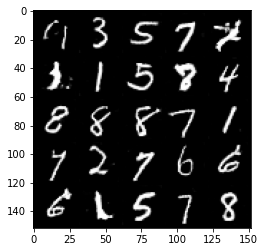

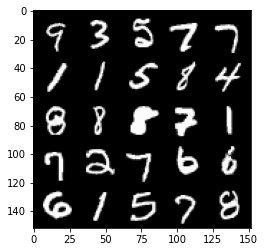

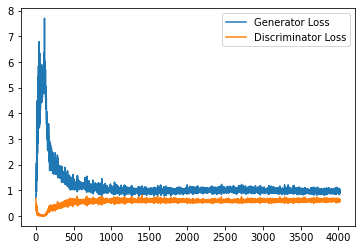

Step 81000: Generator loss: 0.969843996167183, discriminator loss: 0.6162741282582282


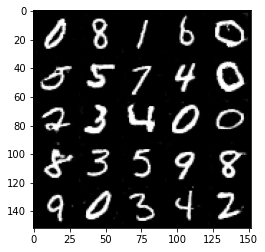

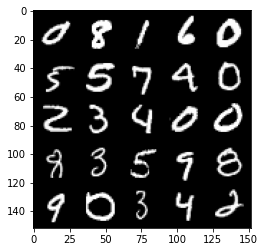

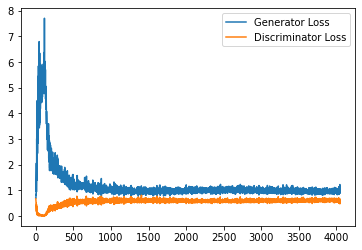

Step 81500: Generator loss: 0.960122249007225, discriminator loss: 0.6125563452839852


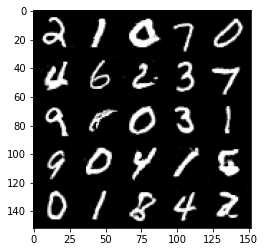

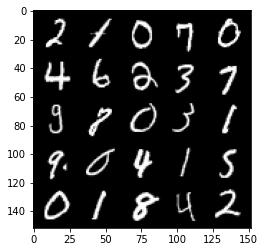

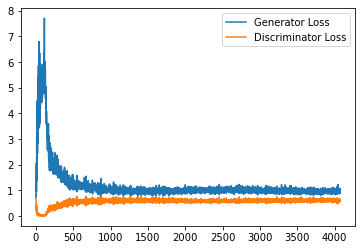

Step 82000: Generator loss: 0.9596082142591477, discriminator loss: 0.6159593151211739


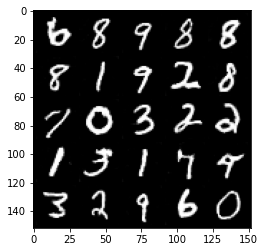

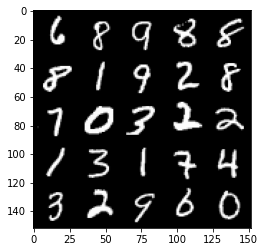

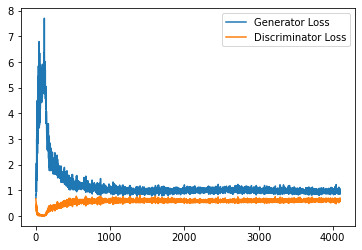

Step 82500: Generator loss: 0.9456999673843384, discriminator loss: 0.6175083904266357


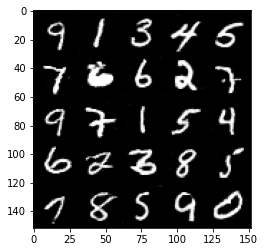

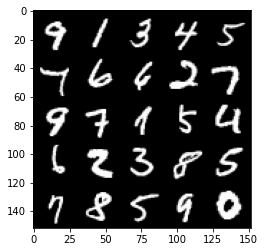

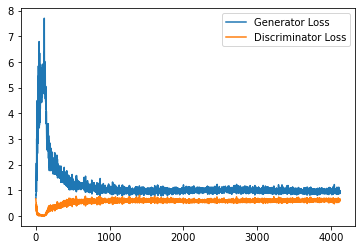

Step 83000: Generator loss: 0.9543622829914093, discriminator loss: 0.6142245466709138


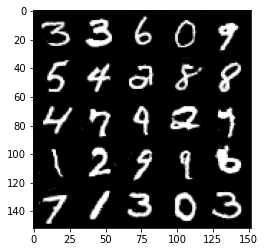

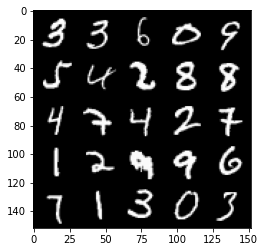

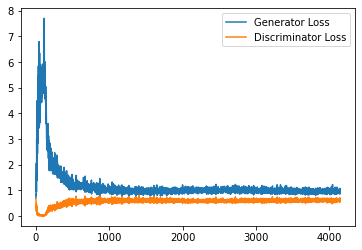

Step 83500: Generator loss: 0.976965656876564, discriminator loss: 0.6156397780179977


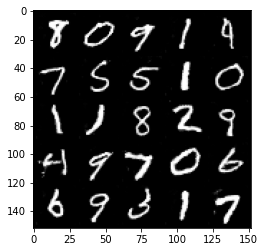

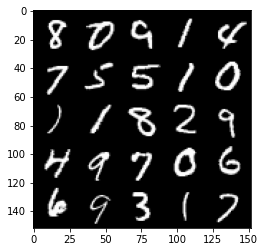

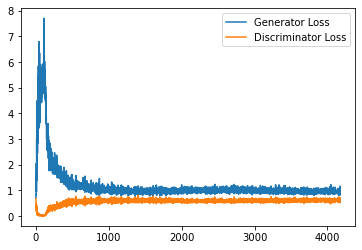

Step 84000: Generator loss: 0.967325900554657, discriminator loss: 0.6161152913570404


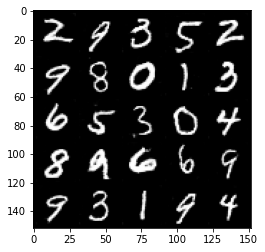

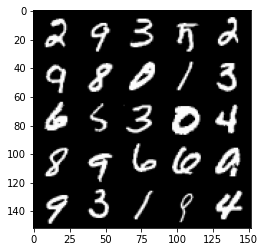

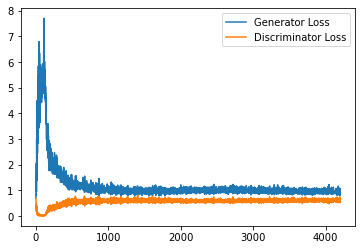

Step 84500: Generator loss: 0.9589912067651749, discriminator loss: 0.6143071662783622


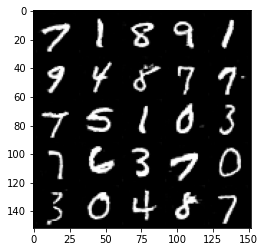

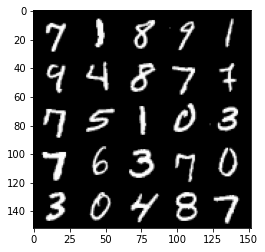

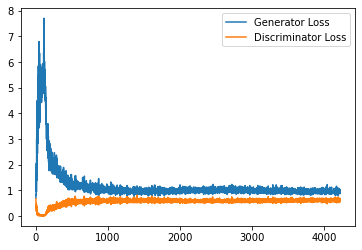

Step 85000: Generator loss: 0.9400722360610962, discriminator loss: 0.6214396531581878


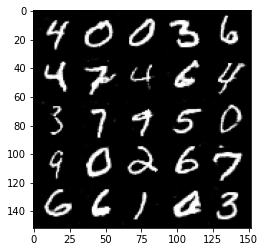

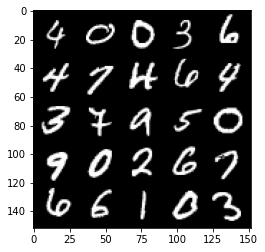

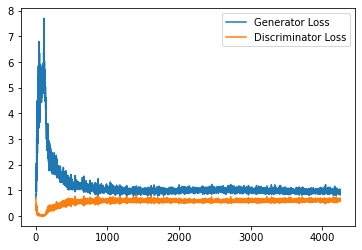

Step 85500: Generator loss: 0.9620099853277206, discriminator loss: 0.6105773503184319


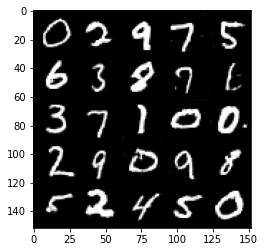

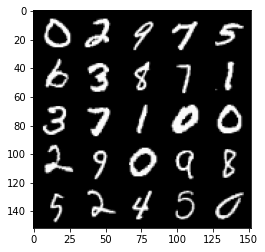

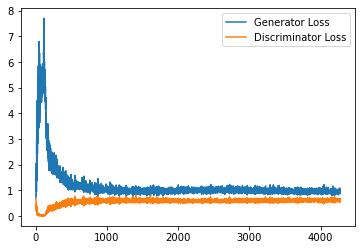

Step 86000: Generator loss: 0.9526076642274857, discriminator loss: 0.6136930188536645


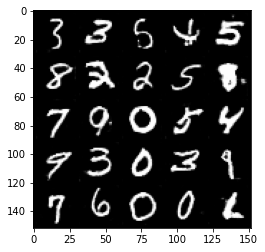

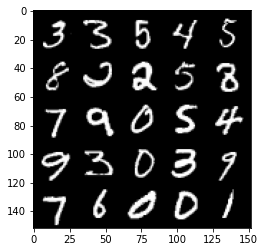

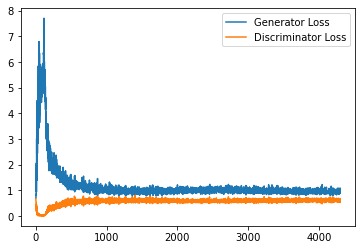

Step 86500: Generator loss: 0.9519405440092087, discriminator loss: 0.6168815640211105


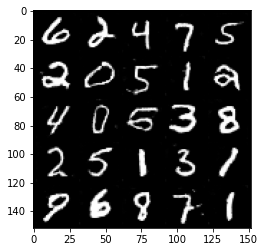

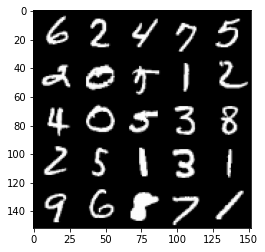

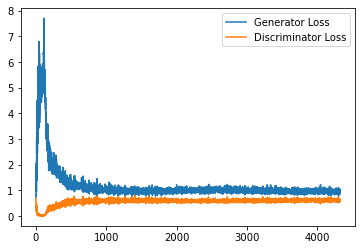

Step 87000: Generator loss: 0.9501100368499756, discriminator loss: 0.6138352192640305


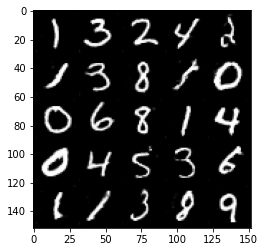

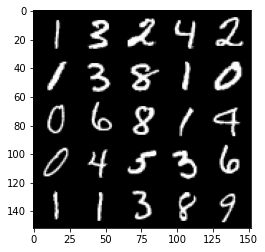

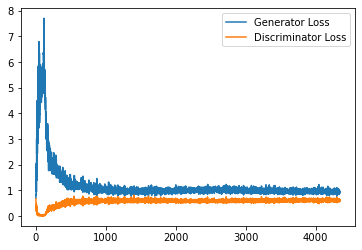

Step 87500: Generator loss: 0.936015052318573, discriminator loss: 0.6168327605724335


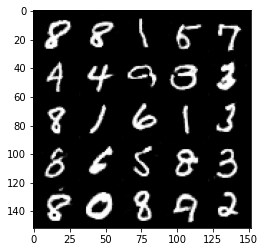

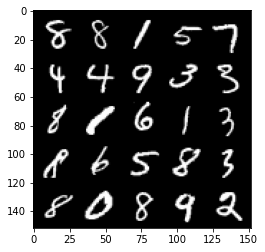

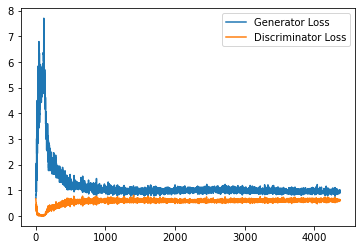

Step 88000: Generator loss: 0.9586316624879837, discriminator loss: 0.6202274073958397


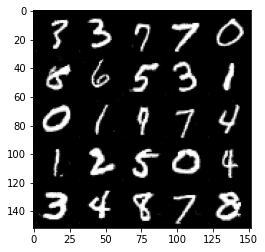

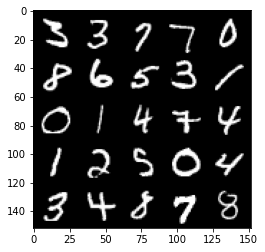

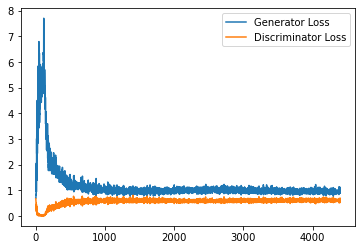

Step 88500: Generator loss: 0.9523450821638108, discriminator loss: 0.618337575495243


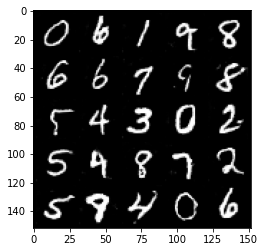

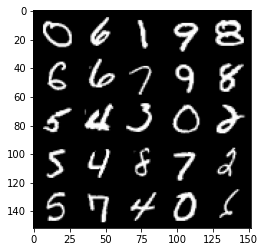

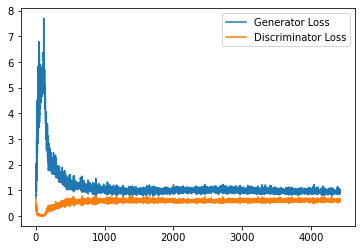

Step 89000: Generator loss: 0.9465704597234726, discriminator loss: 0.6212277392745018


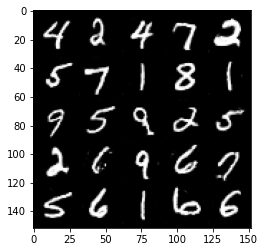

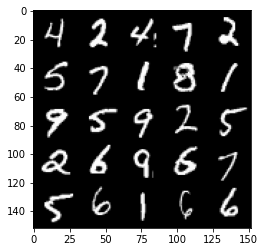

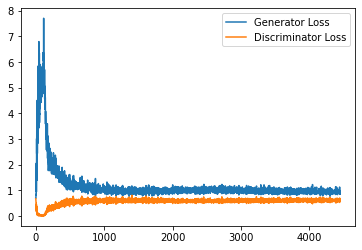

Step 89500: Generator loss: 0.9367898081541062, discriminator loss: 0.6199500840306282


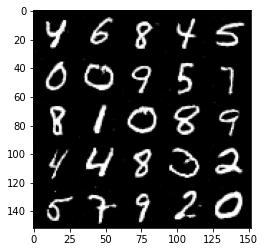

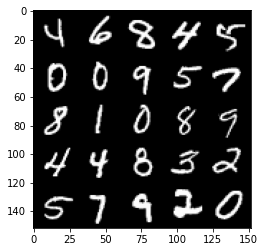

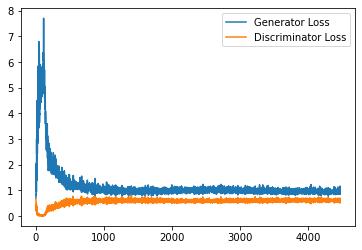

Step 90000: Generator loss: 0.9360114169120789, discriminator loss: 0.6210136198401451


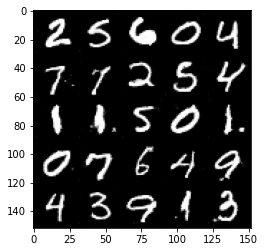

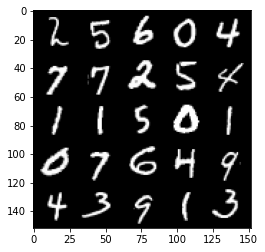

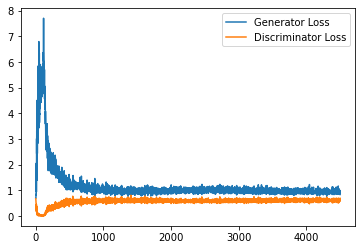

Step 90500: Generator loss: 0.9497403407096863, discriminator loss: 0.6190774853825569


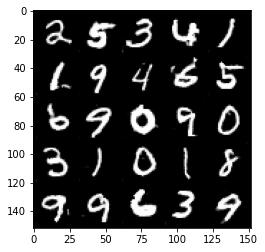

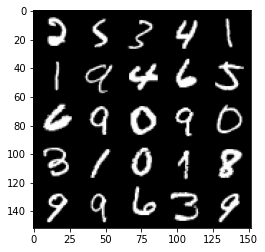

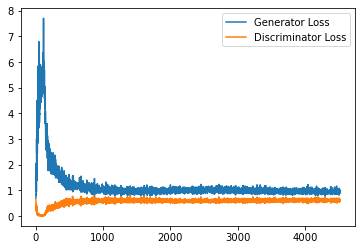

Step 91000: Generator loss: 0.9523775832653045, discriminator loss: 0.623444185435772


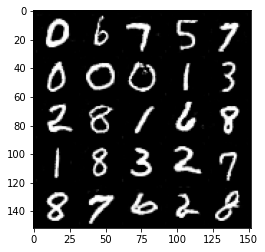

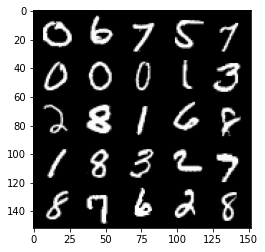

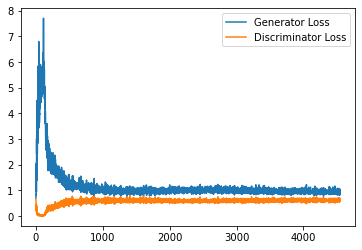

Step 91500: Generator loss: 0.951571231007576, discriminator loss: 0.623459039747715


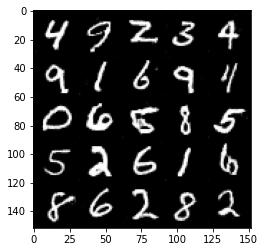

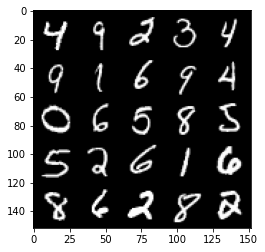

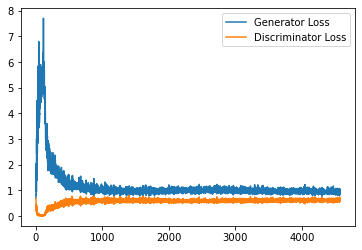

Step 92000: Generator loss: 0.9447163536548614, discriminator loss: 0.6180010904073715


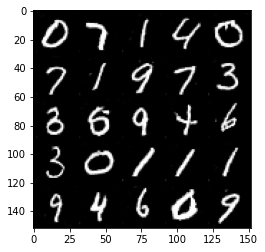

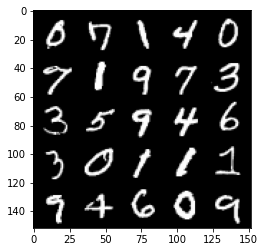

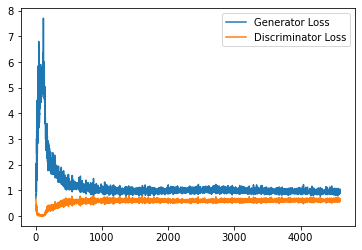

Step 92500: Generator loss: 0.9445639182329177, discriminator loss: 0.6197252613306046


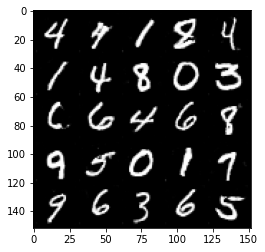

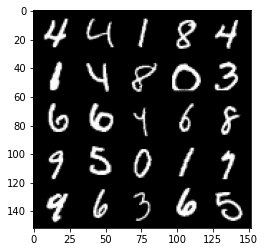

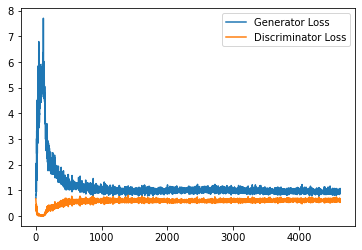

Step 93000: Generator loss: 0.9276483753919601, discriminator loss: 0.6254640700221061


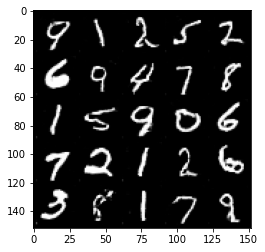

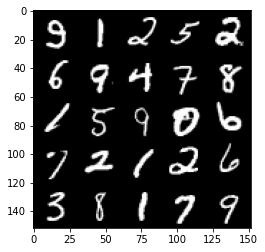

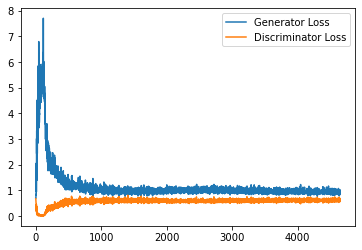

Step 93500: Generator loss: 0.9444201921224594, discriminator loss: 0.6224163951873779


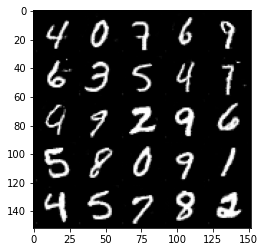

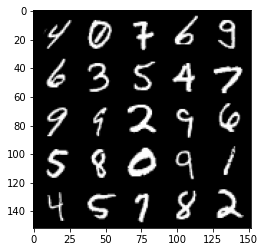

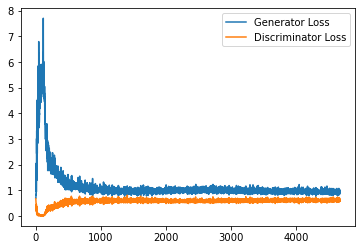

In [13]:
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)
        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
        noise_and_labels = combine_vectors(fake_noise.float(), one_hot_labels.float())
        fake = gen(noise_and_labels)
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels).detach()
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [ ]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

In [ ]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

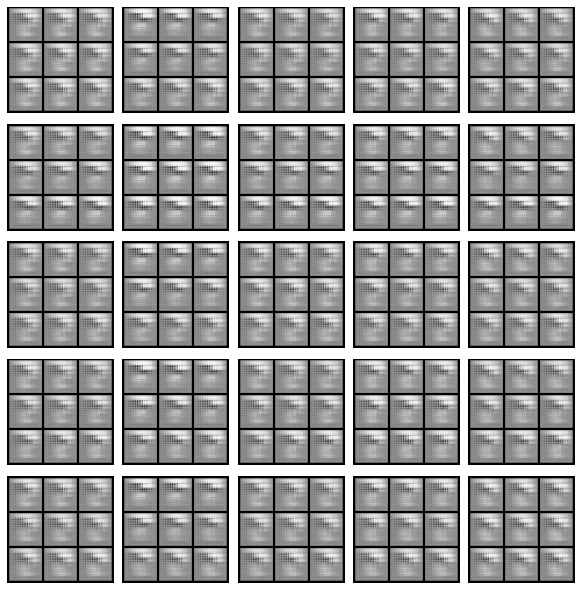

In [52]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()